# Aeolian Alexanders: Economic, Material, and Social Networks in Antiquity

<a href = "https://orcid.org/0000-0002-5009-3116"><img src="img/ORCIDiD_iconvector.svg" alt="orcid ID button" style="width: 20px; float: right"/></a> By [Ryan Horne](https://rmhorne.org/) 

<img src="img/aeolian-coin-header.png" alt="Coin splash image" style="width: 800px;"/>

Supported by a NEH - Mellon Digital Publication Grant 
<br/>
<img src="img/neh_seal.jpg" alt="NEH Seal" style="width: 200px;" align="left"/>

# Introduction

*Aeolian Alexanders* is an exploration in the use of digital tools and publishing to conduct a numismatic die study. Generously supported by a NEH-Mellon digital publication grant, this work seeks to not only add to scholarship on the topic of Hellenistic coinage in Aeolis, but to also offer some new digital tools and methodologies that can be used in numismatics, the study of pre-modern political and economic networks, and more broadly in the study of material culture.

Much of the technology and techniques used here are experimental, and as a result some of the tables, networks, and visualizations are suggestive abstractions instead of definitive statements. This is a living project; even with digital "publication", the tools are still open for refinement and further work, more coins can be added to the database, and the data structures themselves may change upon further consultation with the larger ancient studies linked open data (LOD) community. Much like our knowledge of coins can be radically altered by the discovery of a single hoard, this project could change rapidly as new technologies and methodologies are developed. The rapid development of geographic information systems (GIS), digital gazetteers, and social network analysis software (SNA), combined with a growing collection of LOD resources, has enabled this project to reimagine die-studies and ancient societies as networks which can be visualized and modeled in an approachable way. The choice of an open-access digital platform for publication, instead of a traditional specialist publication, is an effort to not only make not only the product of scholarly research, but the tools and techniques of the craft accessible to as wide an audience as possible. It is my contention that offering all of the coin images, data, and software used by this study in such an open manner will encourage further experimentation, development, and scholarship. If nothing else, this study will hopefully point to the possibilities that new developments in digital humanities can offer to historical studies.

For specialists in the field, this study offers new tools and techniques for the study of numismatics. Some of them, like a tool to aid in the sorting and cataloging of dies, along with a python notebook demonstrating the use of statistical software, can be used without much modification. Other methodologies, like the use of network analysis to study mint and hoard relationships and least-cost pathing to build spatial networks may be controversial; I hope that this project will serve as a stepping stone to further discussion and exploration of how spatial studies and network analysis can reshape our conception of the ancient world.

For an excellent introduction to Jupyter Notebooks, consult [*Introduction to Jupyter Notebooks*](https://programminghistorian.org/en/lessons/jupyter-notebooks) on *The Programming Historian*. You will need to install several different packages and extensions to get full functionality from the notebook; [cite2c](https://github.com/takluyver/cite2c) will display all of the Zotero citations and a full bibliography.

# [Skip to the narrative](#study)



# Program Logic

The code bloicks below setup the program logic for the die study, For further details and explanation, see the [jupyter notebook](https://github.com/Aeolian-Alexanders/jupyter_notebooks) and the [GitHub Site](https://github.com/Aeolian-Alexanders) which houses all of the project's code, coin images, and data. To run this notebook you will need to have various software packages installed; a "fixed" version of this study is [available](https://github.com/Aeolian-Alexanders) for consultation. However, this is not reflective of the current, living  database.

## Headers

These are include files that are necessary for the notebook to run; you may need to install additional packages depending on your python environment.

In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-

import pandas as pd
import sqlalchemy
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
import matplotlib
import argparse
import numpy as np
import matplotlib.font_manager as font_manager
import json
from matplotlib.ticker import FormatStrFormatter
import folium
from folium import plugins
import networkx as nx
import community
import matplotlib.cm as cm
from matplotlib.colors import Normalize
from pygraphviz import *
from networkx.algorithms import bipartite
from folium.features import DivIcon
from natsort import natsorted
import sqlite3
import requests
from operator import itemgetter

### For consistent styling of our charts

In [2]:
from matplotlib import rc
plt.rcParams['ps.useafm'] = True
rc('font',**{'family':'sans-serif','sans-serif':['Helvetica']})
plt.rcParams['pdf.fonttype'] = 42

SMALLEST_SIZE = 12
SMALL_SIZE = 20
MEDIUM_SIZE = 22
BIGGER_SIZE = 24

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

plt.rcParams.update({"axes.facecolor" : "cacaca"})

## Import the database
This imports the latest version of the Aeolian Alexanders database, so the die study always reflects the latest coin and statistical information.

In [3]:
import requests

url = 'https://github.com/Aeolian-Alexanders/data/raw/master/sqlite%20database/aeolian_alexanders.db'
r = requests.get(url, allow_redirects=True)

open('aeolian_alexanders.db', 'wb').write(r.content)

from sqlalchemy import create_engine 
cnx = create_engine('sqlite:///aeolian_alexanders.db')

## Function to create the map
## NOTE: YOU WILL NEED TO PUT IN YOUR OWN CREDENTIALS TO VIEW THE MAP

In [4]:
### createmapvis makes our basic map
def createmapvis():
    
    m = folium.Map(
        location=[40.58058, 36.29883], 
        zoom_start=5,
        zoom_control=False,
        tiles='https://api.mapbox.com/v4/isawnyu.map-knmctlkh/{z}/{x}/{y}.png?access_token=XXXXXXXXXXXXX',
        API_key='XXXXXXXXXXXXX',
        name='AWMC Base',
        attr= attr)
    
    return m

## Data Structures for the study

In [5]:
# mints are defined by their Pleiades IDs; this could easily be changed to Nomisma IDs depending on your data setup
mint = {
    'temnos': '550908',
    'myrina': '550756',
    'kyme': '550506'
}


histogramSizes = {
    'x': 15,
    'y': 5
}

#These structures are here to make the code in the narrative cleaner when I want to show network maps
#Consult the project notebook on *HOW* to create these maps; we can not do this live without a public database
#that runs pgrouting, etc.


attalid_networks_241_197 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Attalid_Kingdom_241_bce_to_197_bce_routes.geojson",
    'featuregroupname': 'Attalid "Routes" 241 - 197 BCE',
    'sizeproperty': 'count'
}

attalid_points_241_197 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Attalid_Kingdom_241_bce_to_197_bce_points.geojson",
    'featuregroupname': 'Attalid Cities 241 - 197 BCE',
    'sizeproperty': 'count'
}


seleukid_networks_241_197 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Seleucid_Kingdom_241_bce_to_197_bce_routes.geojson",
    'featuregroupname': 'Seleukid "Routes" 241 - 197 BCE',
    'sizeproperty': 'count'
}

seleukid_points_241_197 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Seleucid_Kingdom_241_bce_to_197_bce_points.geojson",
    'featuregroupname': 'Seleukid "Routes" 241 - 197 BCE',
    'sizeproperty': 'count'
}

ptolemaic_networks_241_197 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Ptolemaic_Kingdom_241_bce_to_197_bce_routes.geojson",
    'featuregroupname': 'Ptolemaic "Routes" 241 - 197 BCE',
    'sizeproperty': 'count'
}

ptolemaic_points_241_197 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Ptolemaic_Kingdom_241_bce_to_197_bce_points.geojson",
    'featuregroupname': 'Ptolemaic "Routes" 241 - 197 BCE',
    'sizeproperty': 'count'
}



attalid_networks_197_160 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Attalid_Kingdom_197_bce_to_160_bce_routes.geojson",
    'featuregroupname': 'Attalid "Routes" 197 - 160 BCE',
    'sizeproperty': 'count'
}


attalid_points_197_160 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Attalid_Kingdom_197_bce_to_160_bce_points.geojson",
    'featuregroupname': 'Attalid "Routes" 197 - 160 BCE',
    'sizeproperty': 'count'
}


seleukid_networks_197_160 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Seleucid_Kingdom_197_bce_to_160_bce_routes.geojson",
    'featuregroupname': 'Seleukid "Routes" 197 - 160 BCE',
    'sizeproperty': 'count'
}

seleukid_points_197_160 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Seleucid_Kingdom_197_bce_to_160_bce_points.geojson",
    'featuregroupname': 'Seleukid "Routes" 197 - 160 BCE',
    'sizeproperty': 'count'
}

ptolemaic_networks_197_160 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Ptolemaic_Kingdom_197_bce_to_160_bce_routes.geojson",
    'featuregroupname': 'Ptolemaic "Routes" 197 - 160 BCE',
    'sizeproperty': 'count'
}

ptolemaic_points_197_160 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Ptolemaic_Kingdom_197_bce_to_160_bce_points.geojson",
    'featuregroupname': 'Ptolemaic "Routes" 197 - 160 BCE',
    'sizeproperty': 'count'
}


attalid_networks_160_138 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Attalid_Kingdom_160_bce_to_138_bce_routes.geojson",
    'featuregroupname': 'Attalid "Routes" 160 - 138 BCE',
    'sizeproperty': 'count'
}

attalid_points_160_138 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Attalid_Kingdom_160_bce_to_138_bce_points.geojson",
    'featuregroupname': 'Attalid "Routes" 160 - 138 BCE',
    'sizeproperty': 'count'
}


seleukid_networks_160_138 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Seleucid_Kingdom_160_bce_to_138_bce_routes.geojson",
    'featuregroupname': 'Seleukid "Routes" 160 - 138 BCE',
    'sizeproperty': 'count'
}


seleukid_points_160_138 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Seleucid_Kingdom_160_bce_to_138_bce_points.geojson",
    'featuregroupname': 'Seleukid "Routes" 160 - 138 BCE',
    'sizeproperty': 'count'
}

ptolemaic_networks_160_138 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Ptolemaic_Kingdom_160_bce_to_138_bce_routes.geojson",
    'featuregroupname': 'Ptolemaic "Routes" 160 - 138 BCE',
    'sizeproperty': 'count'
}


ptolemaic_points_160_138 = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/imperial_routes/Ptolemaic_Kingdom_160_bce_to_138_bce_points.geojson",
    'featuregroupname': 'Ptolemaic "Routes" 160 - 138 BCE',
    'sizeproperty': 'count'
}


autonomus_cities = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/post_apamea_autonomus_cities.geojson",
    'featuregroupname': 'Autonomus Cities',
    'popup': 'title'
}


temnos_routes = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/temnos_hoard_routes.geojson",
    'featuregroupname': 'Temnos to Hoard Routes',
    'sizeproperty': 'count'
}


myrina_routes = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/myrina_hoard_routes.geojson",
    'featuregroupname': 'Myrina to Hoard Routes',
    'sizeproperty': 'count'
}


kyme_routes = {
    'url': "https://raw.githubusercontent.com/Aeolian-Alexanders/geodata/master/kyme_hoard_routes.geojson",
    'featuregroupname': 'Kyme to Hoard Routes',
    'sizeproperty': 'count'
}

# attribution for the map
attr = """
Tiles &copy; <a href='http://mapbox.com/' target='_blank'>MapBox</a> |
 Data &copy; <a href='http://www.openstreetmap.org/' target='_blank'>OpenStreetMap</a> and contributors, CC-BY-SA |
 Tiles and Data &copy; 2020 <a href='http://www.awmc.unc.edu' target='_blank'>AWMC</a>
 <a href='http://creativecommons.org/licenses/by-nc/3.0/deed.en_US' target='_blank'>CC-BY-NC 3.0</a>
"""

## Functions
These function s enable the display of our graphs and charts from the database. They are based on imput parameters, so someone can see different groupings, time periods, etc

In [6]:
def linReScale (oldmax, oldmin, newmax, newmin, oldnumber):
    newnumber = (oldnumber - oldmin) / (oldmax - oldmin) * (newmax - newmin) + newmin
    return newnumber

def makeNetColor (row, my_colors):
    netColor = matplotlib.colors.to_hex(my_colors(row['partition']))
    #netColor = my_colors(row['partition'])
    return netColor

#def makePleiadesGeoDataFromList(inputfile, id_column, outputname):
#    pleaidesdf = pd.DataFrame()
#    pleaidesdf = pd.read_csv(inputfile)  
#    pleiadesIdList = pleaidesdf['pid'].tolist()
#    sql = 'SELECT id, title, geom from places where ' + ' or '.join(('id = ' + str(n) for n in pleiadesIdList))
##    pleiadesGeodf = gpd.GeoDataFrame.from_postgis(sql, cnx, geom_col='geom' )
 #   pleiadesGeodf.to_file(outputname, driver="GeoJSON")
    
def make_clickable(val):
    # target _blank to open new window
    return '<a target="_blank" href="https://maps.isaw.nyu.edu/aeolis/coins/{val}">{val}</a>'.format(val = val)

def make_clickableBase(val):
    # target _blank to open new window
    return '<a target="_blank" href="{val}">{val}</a>'.format(val = val)


#This produces a "traditional" coin catalog. This can be sorted if desired.
def coinCatalogWorking (mint):
    sql = """
    SELECT coinid AS id,
    typeid AS type,
    obvdie AS obverse,
    revdie AS reverse,
    weight,
    rotation,
    size,
    title
    FROM all_coins
    where mint = '{mint}' 
    AND obvdie !=''
    AND obvdie !='dupe'
    AND obvdie !='no_image'
    AND revdie !=''
    
    
    ORDER BY type, obverse, reverse
    """.format(mint = mint)
    
    dfCoinCat = pd.read_sql_query(sql, cnx)
    dfCoinCat["weight"] = pd.to_numeric(dfCoinCat["weight"])

    return dfCoinCat
#this displays all of the different charts in the "traditional" type format
def typeinfochart(mint):
    dfObverseCount = pd.DataFrame()
    dfObverseCount = typestoObverseCounter(mint)
    dfCoinCount = pd.DataFrame()
    dfCoinCount = typescoincounts(mint)
    dfavgweight = pd.DataFrame()
    dfavgweight = typesweightaverager(mint)
    dfObvinfo = pd.DataFrame()
    dfObvinfo = dfCoinCount.copy()
    dfObvinfo = dfObvinfo.merge(dfObverseCount, how='left')
    dfObvinfo = dfObvinfo.merge(dfavgweight, how='left')
    dfObvinfo.set_index('type', inplace=True)
    return dfObvinfo

#creates a type to obverse chart
def typestoObverseCounter(mint):
    sql = """
    Select typeid AS type, count(distinct obvdie) as number_of_obverse_dies
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    AND
    typeid IS NOT NULL
    AND
    typeid != ''
    group by type
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['type']
    df = df.sort_index().reset_index(drop=True)
    return df

#creates a type to mint chart
def typescoincounts(mint):
    sql = """
    Select typeid AS type, count(distinct id) as number_of_coins
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    AND
    typeid IS NOT NULL
    AND
    typeid != ''
    group by typeid
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['type']
    df = df.sort_index().reset_index(drop=True)
    return df

#creates a type to weight chart
def typesweightaverager(mint):
    sql = """
    Select typeid AS type, AVG(CAST(weight as decimal)) as average_weight
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    AND
    typeid IS NOT NULL
    AND
    typeid != ''
    group by typeid
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['type']
    df = df.sort_index().reset_index(drop=True)
    return df

#this function displays hoards associated with a chosen mint in a catalog. 
def hoardsDisplay (mint, startdate, enddate, buffer):
    mintUri = 'https://pleiades.stoa.org/places/' + mint
    sd = startdate - buffer;
    ed = enddate - buffer;
    
    sql = """
        SELECT aa_hoards.hoard_id as id,
        MAX(aa_hoards.title) AS title,
        SUM(aa_mints.count) AS count,
        MAX(aa_hoards.b_start_date) AS burial_start,
        MAX(aa_hoards.b_end_date) AS burial_end,
        MAX(aa_hoards.contents) AS contents,
        MAX(aa_hoards.ex_start_date) AS discovered_at,
        MAX(aa_hoards.location_uri) AS location_uri
        FROM
        aa_mints
        LEFT JOIN
        aa_hoards
        ON
        aa_mints.hoard = aa_hoards.hoard_id
        WHERE 
        CAST(b_start_date as decimal) >= {sd} and CAST(b_end_date as decimal) <= {ed}
        AND
        aa_hoards.hoard_id NOT IN (SELECT cross_reference FROM aa_parent_child)
        AND
        aa_hoards.hoard_id IN (SELECT aa_mints.hoard from aa_mints WHERE aa_mints.mint_uri = '{mintUri}')
        AND
        aa_mints.mint_uri = '{mintUri}'
        GROUP BY aa_hoards.hoard_id, aa_mints.mint_uri
        ORDER BY burial_start; 
    """.format(sd = sd, ed = ed, mintUri=mintUri)
    dfHoardCat = pd.read_sql_query(sql, cnx)
    
    return dfHoardCat


#This function maps hoards which are associated with a selected mint
def mintHoardMapper (hoarddf, nodeAttribute, mint, nodeMinSize, nodeMaxSize, m):
    
    sql = """
    SELECT aa_locations.id AS location_uri, aa_locations.lat, aa_locations.lon FROM aa_locations;
    """
    locdf = pd.DataFrame()
    locdf = pd.read_sql_query(sql, cnx)
    
    finaldf = hoarddf[(hoarddf['location_uri']!="null")]
    finaldf = finaldf[(finaldf['location_uri']!="")]
    finaldf = finaldf.merge(locdf, how='left')
    
    finaldf['lat'] = pd.to_numeric(finaldf['lat'])
    finaldf['lon'] = pd.to_numeric(finaldf['lon'])
    finaldf['count'] = pd.to_numeric(finaldf['count'])
    
    oldmax = hoarddf[nodeAttribute].max()
    oldmin = hoarddf[nodeAttribute].min()
    
    finaldf['size'] = linReScale(oldmax, oldmin, nodeMaxSize, nodeMinSize, finaldf['count'])

    
    for index, row in finaldf.iterrows():
        if float(row['lat']) < 9999999:
            popupText = '{title}'.format(title = row['title'])
            folium.CircleMarker(location = [row['lat'], row['lon']],
                                popup = popupText,
                                radius = row['size'],
                                fill_color='black', 
                                color = 'black', 
                                fill_opacity=0.7,
                                weight = .5
                               ).add_to(m)
    # now to put in the mint
    
    sql = """
    SELECT places.id, places.title, places.reprlat, places.reprlong
    FROM places
    WHERE id = {mint};
    """.format(mint = mint)
    
    mintdf = pd.DataFrame()
    mintdf = pd.read_sql_query(sql, cnx)
    title = mintdf['title']
    folium.Marker([mintdf['reprlat'], mintdf['reprlong']], popup='{title}'.format(title = title)).add_to(m)
    
    return m


def obversetoreversecounter(mint):
    sql = """
    Select obvdie AS obverse_die, count(distinct revdie) as number_of_reverse_dies
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    group by obvdie
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['obverse_die'].str.replace('[a-zA-Z_]+','').astype(float)
    df = df.sort_index().reset_index(drop=True)
    return df


def obversetoreversecounter(mint):
    sql = """
    Select obvdie AS obverse_die, count(distinct revdie) as number_of_reverse_dies
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    group by obvdie
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['obverse_die'].str.replace('[a-zA-Z_]+','').astype(float)
    df = df.sort_index().reset_index(drop=True)
    return df


def obverseweightaverager(mint):
    sql = """
    Select obvdie AS obverse_die, AVG(CAST(weight as decimal)) as average_weight
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    group by obvdie
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['obverse_die'].str.replace('[a-zA-Z_]+','').astype(float)
    df = df.sort_index().reset_index(drop=True)
    return df

def obversecoincounter(mint):
    sql = """
    Select obvdie AS obverse_die, count(obvdie) AS number_of_coins
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    group by obvdie
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['obverse_die'].str.replace('[a-zA-Z_]+','').astype(float)
    df = df.sort_index().reset_index(drop=True)
    return df


def obverseToTypeList (mint):
    sql = """
    Select obvdie AS obverse_die, group_concat(DISTINCT typeid) as price_types
    from
    all_coins
    where mint = '{mint}'
    AND
    obvdie IS NOT NULL
    AND
    obvdie != ''
    AND
    obvdie !='dupe'
    AND
    obvdie !='no_image'
    AND
    typeid !=''
    AND
    typeid IS NOT NULL
    group by obvdie
    """.format(mint = mint)
    
    df = pd.DataFrame()
    df = pd.read_sql_query(sql, cnx)
    df = sortMixedDatatable(df)

    return df

def obvinfochart(mint):
    dfObverseReverseCount = pd.DataFrame()
    dfObverseReverseCount = obversetoreversecounter(mint)
    dfobvprice = pd.DataFrame()
    dfobvprice = obverseToTypeList(mint)
    dfobvavgweight = pd.DataFrame()
    dfobvavgweight = obverseweightaverager(mint)
    dfobvcoincount = pd.DataFrame()
    dfobvcoincount = obversecoincounter(mint)
    dfObvinfo = pd.DataFrame()
    dfObvinfo = dfobvcoincount.copy()
    dfObvinfo = dfObvinfo.merge(dfObverseReverseCount, how='left')
    dfObvinfo = dfObvinfo.merge(dfobvavgweight, how='left')
    dfObvinfo = dfObvinfo.merge(dfobvprice, how='left')
    dfObvinfo.set_index('obverse_die', inplace=True)
    return dfObvinfo

def sortMixedDatatable (df):
    #we usually have mixed numbers and characters for naming conventions; this should arrange everythign nicely
    df.index = df['obverse_die'].str.replace('[a-zA-Z_]+','').astype(float)
    df = df.sort_index().reset_index(drop=True)
    return df


# SQL to get the mints / hoards as source, target with counts for weights
def coinNetworkSql(startdate, enddate, buffer):
    sd = startdate - buffer;
    ed = enddate - buffer;
    sql = """
        SELECT  aa_mints.mint_uri as source, 
        aa_hoards.location_uri as target, 
        LOWER(aa_mints.mint) as label, 
        SUM(aa_mints.count) as weight
    FROM
    aa_mints
    LEFT JOIN
    aa_hoards
    ON
    aa_mints.hoard = aa_hoards.hoard_id
    WHERE 
    CAST(b_start_date as decimal) >= {sd} and CAST(b_end_date as decimal) <= {ed}
    AND
    aa_hoards.hoard_id NOT IN (SELECT cross_reference FROM aa_parent_child)
    AND
    aa_mints.mint_uri IS NOT NULL 
    AND 
    aa_mints.mint_uri <> ''
    AND aa_hoards.location_uri <> ''
    GROUP BY source, target, label
    ORDER BY label; 
    """.format(sd = sd, ed = ed)
    return sql

def makeweightgraph(df, fontsize, title, xlabel, ylabel, ylimit, bar_width):
    plt.rcParams.update({'font.size': fontsize})
    bar_width = bar_width
    
    fig, ax = plt.subplots()
    ax = df.plot(kind = 'bar', zorder=100, width=bar_width, label='Weight')
    
    plt.title(title, fontsize=fontsize+2)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    
    axes = plt.gca()
    axes.set_ylim([ylimit,None])
    
    for tick in ax.get_xticklabels():
        tick.set_rotation(45)
        figure = plt.gcf() # get current figure
        figure.set_size_inches(20, 8.5)
        
    plt.show()
    
def maketypeweightgraph(coinType, cleanedList, bar_width, sizex, sizey):
    coinType = coinType
    bar_width = bar_width
    plt.figure(figsize=(sizex,sizey))
    ax = plt.hist(cleanedList, label="Number of Coins", bins=20, rwidth=bar_width)
    plt.ylabel('Number of Coins')
    plt.xlabel('Weight')
    plt.title("Weight histogram for {coinType}".format(coinType=coinType))
    plt.xticks(rotation=45)
    plt.show()
    
#this styles the networks according to the number of crossing routes    
def addNetworkRoutesFromFile(url, featuregroupname, sizeproperty, fillColor, routeMaxSize, routeMinSize, m):
    js_data = json.loads(requests.get(url).text)
    fg = folium.map.FeatureGroup(name=featuregroupname).add_to(m)
    
    oldmax = max(js_data['features'], key=lambda ev: ev['properties'][sizeproperty])['properties'][sizeproperty]
    oldmin = min(js_data['features'], key=lambda ev: ev['properties'][sizeproperty])['properties'][sizeproperty]
    
    for feature in js_data['features']:
        fillColor = fillColor
        color = fillColor
        weight = linReScale(oldmax, oldmin, routeMaxSize, routeMinSize, feature['properties'][sizeproperty])
        b = folium.GeoJson(feature,
                       style_function=lambda x, fillColor=fillColor, color=color, weight=weight: {
           "fillColor": fillColor,
            "color": fillColor,
            'weight': weight,
            'fillOpacity': 0.5,
            'opacity': 0.5
        })
        fg.add_child(b)
        
        
#this adds cities within each polity    
def addNetworkPointsFromFile(url, featuregroupname, radius, fillColor, popupfield, m):
    js_data = json.loads(requests.get(url).text)
    fg = folium.map.FeatureGroup(name=featuregroupname).add_to(m)
    
    for feature in js_data['features']:
        fillColor = fillColor
        radius=radius
        if (feature['geometry']):
            lat = feature['geometry']['coordinates'][1]
            lon = feature['geometry']['coordinates'][0]
            b = folium.Circle(
                location=[lat, lon],
                popup=feature['properties'][popupfield],
                radius=radius,
                color='black',
                fill=True,
                fill_color=fillColor)
            fg.add_child(b) 
            
            
#this function displays hoards associated with a chosen mint in a catalog. 
def hoardsDisplay (mint, startdate, enddate, buffer):
    mintUri = 'https://pleiades.stoa.org/places/' + mint
    sd = startdate - buffer;
    ed = enddate - buffer;
    
    sql = """
        SELECT aa_hoards.hoard_id as id,
        MAX(aa_hoards.title) AS title,
        SUM(aa_mints.count) AS count,
        MAX(aa_mints.denomination) AS denomination,
        MAX(aa_mints.type) AS type,
        MAX(aa_hoards.b_start_date) AS burial_start,
        MAX(aa_hoards.b_end_date) AS burial_end,
        MAX(aa_hoards.contents) AS contents,
        MAX(aa_hoards.ex_start_date) AS discovered_at,
        MAX(aa_hoards.location_uri) AS location_uri
        FROM
        aa_mints
        LEFT JOIN
        aa_hoards
        ON
        aa_mints.hoard = aa_hoards.hoard_id
        WHERE 
        CAST(b_start_date as decimal) >= {sd} and CAST(b_end_date as decimal) <= {ed}
        AND
        aa_hoards.hoard_id NOT IN (SELECT cross_reference FROM aa_parent_child)
        AND
        aa_hoards.hoard_id IN (SELECT aa_mints.hoard from aa_mints WHERE aa_mints.mint_uri = '{mintUri}')
        AND
        aa_mints.mint_uri = '{mintUri}'
        GROUP BY aa_hoards.hoard_id, aa_mints.mint_uri
        ORDER BY burial_start; 
    """.format(sd = sd, ed = ed, mintUri=mintUri)
    dfHoardCat = pd.read_sql_query(sql, cnx)
    
    return dfHoardCat

#This function maps hoards which are associated with a selected mint
def mintHoardMapper (hoarddf, nodeAttribute, mint, nodeMinSize, nodeMaxSize, m):
    
    sql = """
    SELECT aa_locations.id AS location_uri, aa_locations.lat, aa_locations.lon FROM aa_locations;
    """
    locdf = pd.DataFrame()
    locdf = pd.read_sql_query(sql, cnx)
    
    finaldf = hoarddf[(hoarddf['location_uri']!="null")]
    finaldf = finaldf[(finaldf['location_uri']!="")]
    finaldf = finaldf.merge(locdf, how='left')
    
    finaldf['lat'] = pd.to_numeric(finaldf['lat'])
    finaldf['lon'] = pd.to_numeric(finaldf['lon'])
    finaldf['count'] = pd.to_numeric(finaldf['count'])
    
    oldmax = hoarddf[nodeAttribute].max()
    oldmin = hoarddf[nodeAttribute].min()
    
    finaldf['size'] = linReScale(oldmax, oldmin, nodeMaxSize, nodeMinSize, finaldf['count'])

    
    for index, row in finaldf.iterrows():
        if float(row['lat']) < 9999999:
            popupText = '{title}'.format(title = row['title'])
            folium.CircleMarker(location = [row['lat'], row['lon']],
                                popup = popupText,
                                radius = row['size'],
                                fill_color='black', 
                                color = 'black', 
                                fill_opacity=0.7,
                                weight = .5
                               ).add_to(m)
    # now to put in the mint
    
    sql = """
    SELECT places.id, places.title, places.reprlat, places.reprlong
    FROM places
    WHERE id = {mint};
    """.format(mint = mint)
    
    mintdf = pd.DataFrame()
    mintdf = pd.read_sql_query(sql, cnx)
    title = mintdf['title']
    folium.Marker([mintdf['reprlat'], mintdf['reprlong']], popup='{title}'.format(title = title)).add_to(m)
    
    return m

#this displays hoards as an ego network around a chosen mint
def hoardsEgoDisplay (mint, startdate, enddate, buffer):
    sd = startdate - buffer;
    ed = enddate - buffer;
    mintUri = 'https://pleiades.stoa.org/places/' + mint
    sql = """
        SELECT aa_hoards.hoard_id,
        MAX(aa_hoards.title) AS hoard_title,
        MAX(aa_mints.mint) AS mint_title,
        mint_uri,
        SUM(aa_mints.count) AS count,
        MAX(aa_hoards.location_uri) AS location_uri
        FROM
        aa_mints
        LEFT JOIN
        aa_hoards
        ON
        aa_mints.hoard = aa_hoards.hoard_id
        WHERE 
        CAST(b_start_date as decimal) >= {sd} and CAST(b_end_date as decimal) <= {ed}
        AND
        aa_hoards.hoard_id NOT IN (SELECT cross_reference FROM aa_parent_child)
        AND
        aa_hoards.hoard_id IN (SELECT aa_mints.hoard from aa_mints WHERE aa_mints.mint_uri = '{mintUri}')
        AND
        mint_uri != ''
        GROUP BY aa_hoards.hoard_id, mint_uri
        ORDER BY mint_uri; 
    """.format(sd = sd, ed = ed, mintUri=mintUri)    
    
    dfHoardEgo = pd.read_sql_query(sql, cnx)
    return dfHoardEgo

#this displays a graph of all of the coin hoards connected with a mint
def displayCoinEgoHoardGraph (coinHoardGraph, coinHoardGraphDict, maxNodeSize, MinNodeSize, maxEdgeSize, MinEdgeSize, figXsize, figYSize, nodes_df, FontSize):
    
    oldmax = int(max(coinHoardGraphDict.values()))
    oldmin = int(min(coinHoardGraphDict.values()))
    
    for k, v in coinHoardGraphDict.items():
        coinHoardGraphDict[k] = linReScale(oldmax, oldmin, maxNodeSize, MinNodeSize, v)
    
    edgeweights = [i['count'] for i in dict(coinHoardGraph.edges).values()]
    oldmax = max(edgeweights)
    oldmin = min(edgeweights)
    
    edgeweights = [linReScale(oldmax, oldmin, maxEdgeSize, MinEdgeSize, a) for a in edgeweights]
    
    labelcopy = pd.DataFrame()
    labelcopy = nodes_df.copy()
    labellist = labelcopy.filter(['mint_uri','title'])
    labellistDict = pd.Series(labellist.title.values,index=labellist.mint_uri).to_dict()

    
    fig, ax = plt.subplots(figsize=(figXsize,figYSize))
    pos = nx.nx_agraph.graphviz_layout(coinHoardGraph, prog='neato')
    
    nx.draw_networkx_nodes(coinHoardGraph, pos, ax = ax, edgecolors = 'black', node_color=colors, cmap=my_colors, labels=True, node_size=[v * 50 for v in coinHoardGraphDict.values()])
    nx.draw_networkx_edges(coinHoardGraph, pos, width=edgeweights, ax=ax)
    nx.draw_networkx_labels(coinHoardGraph, pos, labellistDict, font_size=FontSize,font_color='black')
    
    plt.show()

#this creates dataframes from our graph data to use for maps and other 
def createMapDfs(dfEgoHoard, partition, graph, colormap):
    smallhoarddf = dfEgoHoard.groupby( ["location_uri", "hoard_id"] ).count().reset_index()
    sql = """
    SELECT aa_locations.id AS location_uri, aa_locations.title, aa_locations.lat, aa_locations.lon FROM aa_locations;
    """
    
    locdf = pd.DataFrame()
    locdf = pd.read_sql_query(sql, cnx)
    smallhoarddf = smallhoarddf.merge(locdf, how='left')
    del smallhoarddf['hoard_title']
    del smallhoarddf['mint_title']
    del smallhoarddf['mint_uri']
    del smallhoarddf['count']
    smallhoarddf.rename(columns={'location_uri':'mint_uri'}, inplace=True)
    smallhoarddf['title'] = smallhoarddf['hoard_id']
    mapDf = pd.DataFrame(coinHoardGraph.nodes, columns =['mint_uri']) 
    partdf = pd.DataFrame(list(partition.items()),columns = ['mint_uri','partition'])
    partdf['color'] = partdf.apply (lambda row: makeNetColor(row, my_colors), axis=1)
    mapDf = mapDf.merge(partdf, how='left')
    weightdf = pd.DataFrame(list(coinHoardGraph.degree(weight='weight')),columns = ['mint_uri','degree']) 
    mapDf = mapDf.merge(weightdf, how='left')
    
    sql = """
    SELECT aa_locations.id AS mint_uri, aa_locations.title, aa_locations.lat, aa_locations.lon 
    FROM aa_locations;
    """
    
    locdf = pd.DataFrame()
    locdf = pd.read_sql_query(sql, cnx)
    
    mapDf = mapDf.merge(locdf, how='left')
    partdf.rename(columns={'mint_uri':'hoard_id'}, inplace=True)
    weightdf.rename(columns={'mint_uri':'hoard_id'}, inplace=True)
    
    smallhoarddf = smallhoarddf.merge(partdf, how='left')
    smallhoarddf = smallhoarddf.merge(weightdf, how='left')
    
    del smallhoarddf['mint_uri']
    smallhoarddf.rename(columns={'hoard_id':'mint_uri'}, inplace=True)
    
    mapDf = mapDf[mapDf['lat'].notna()]
    
    smallhoarddf['lat'] = pd.to_numeric(smallhoarddf['lat'])
    smallhoarddf['lon'] = pd.to_numeric(smallhoarddf['lon'])
    smallhoarddf['degree'] = pd.to_numeric(smallhoarddf['degree'])

    mapDf['lat'] = pd.to_numeric(mapDf['lat'])
    mapDf['lon'] = pd.to_numeric(mapDf['lon'])
    mapDf['degree'] = pd.to_numeric(mapDf['degree'])

    
    dataframeResults['mintsDf'] = mapDf
    dataframeResults['hoardsDf'] = smallhoarddf
    
    mapDf = mapDf.merge(smallhoarddf, how='outer')
    mapDf = mapDf[(mapDf['lat']!="lat")]
    mapDf = mapDf[(mapDf['lat']!="")]
    
    dataframeResults['mapDf'] = mapDf
    
    return dataframeResults

#this function populates a feature group from a datatable, rescaleas it, then adds it to the map

def addFeatureGrouptoMap(df, featuregroup, nodeMaxSize, nodeMinSize, nodeAttribute, nodeTitle, m):
    
    oldmax = df[nodeAttribute].max()
    oldmin = df[nodeAttribute].min()

    for index, row in df.iterrows():
        if float(row['lat']) < 9999999:
            radius = linReScale(oldmax, oldmin, nodeMaxSize, nodeMinSize, row['degree'])
            popupText = 'Title: {title}'.format(title = row[nodeTitle])
            featuregroup.add_child(folium.CircleMarker(location = [row['lat'], row['lon']],
                                popup = popupText,
                                radius = radius,
                                fill_color=row['color'], 
                                color = 'black', 
                                fill_opacity=0.7,
                                weight = .5
                               ))
            m.add_child(featuregroup) 

def addFeatureLabelstoMap(df, nodeTitle, m, fontsize):
    for index, row in df.iterrows():
        if float(row['lat']) < 9999999:
            folium.Marker(location = [row['lat'], row['lon']],
                          icon=DivIcon(
                              icon_size=(15,15),
                              icon_anchor=(0,0),
                              html='<div style="font-size: {fontsize}pt">{label}</div>'.format(label = row[nodeTitle], fontsize = fontsize))
                         ).add_to(m)

#this function maps all of the hoards between two given years, partitions them, and returns a dataframe           
def hoardsGroupMapper(startdate, enddate, buffer, mapcolorramp, featuregroup):
    sql = coinNetworkSql(startdate, enddate, buffer)
    dfmaptest = pd.DataFrame()
    dfmaptest = pd.read_sql_query(sql, cnx)
    mapgraph = nx.from_pandas_edgelist(dfmaptest, 'source', 'target', 'weight')
    partition = community.best_partition(mapgraph)
    modularity = community.modularity(partition, mapgraph)
    dfmap = createMapDataframe(dfmaptest, mapgraph, partition, mapcolorramp)
    return dfmap

### This function creates the dataframe necessary for the map out of all of the various measurements, etc.
def createMapDataframe(dataframe, graph, partition, color_map):
    sql = """
        SELECT aa_locations.id AS source, 
        aa_locations.title, 
        aa_locations.lat, 
        aa_locations.lon, 
        aa_locations.geom FROM aa_locations;
        """
    dataframe = pd.DataFrame()
    dataframe = pd.read_sql_query(sql, cnx)
    partdf = pd.DataFrame(list(partition.items()),columns = ['source','partition'])
    dataframe = dataframe.merge(partdf, how='left')
    weightdf = pd.DataFrame(list(graph.degree(weight='weight')),columns = ['source','weighted_degree']) 
    dataframe = dataframe.merge(weightdf, how='left')
    degreedf = pd.DataFrame(list(graph.degree()),columns = ['source','degree']) 
    dataframe = dataframe.merge(degreedf, how='left')
    dataframe = dataframe[dataframe.partition.notnull()]
    columncolor = dataframe[['source', 'partition']] 
    
    minima = min(columncolor['partition'].tolist())
    maxima = max(columncolor['partition'].tolist())
    norm = matplotlib.colors.Normalize(vmin=minima, vmax=maxima, clip=True)
    mapper = cm.ScalarMappable(norm=norm, cmap=color_map)
    
    aDict = {}
    #since for some reasin the color mapper is not callable within an iterated dataframe, we are going to do this the hard way
    for index, row in dataframe.iterrows():
        aDict[row['source']] = str(matplotlib.colors.to_hex(mapper.to_rgba(row['partition'])))
    
    colordf = pd.DataFrame(list(aDict.items()), columns=['source', 'color'])
    dataframe = dataframe.merge(colordf, how='left')
    
    sql = """
    SELECT aa_locations.id AS location_uri, aa_locations.lat, aa_locations.lon FROM aa_locations;
    """
    locdf = pd.DataFrame()
    locdf = pd.read_sql_query(sql, cnx)


    dataframe = dataframe.merge(locdf, how='left')
    dataframe[["lat", "lon"]] = dataframe[["lat", "lon"]].apply(pd.to_numeric)
    
    return dataframe



# <a id='study'></a>The Study

<img src="img/overview.png" alt="overview map of aeolian cities" style="width: 600px;"/>

# Historical Background

Temnos was an Aeolian polis, well attested in the literary and epigraphical record. Herodotus placed the community in his list of Aeolian cities, including “...Cyme (called “Phriconian”), Lerisae, New Teichos, Temnos, Cilla, Notion, Aegiroessa, Pitane, Aegaeae, Myrina, [and] Gryneia.” (*Hdt.* 1.149) Although absent from the Athenian tribute lists and therefore not a member of the fifth century Delian league, Temnos and its citizens appear with frequency by the 4th century <cite data-cite="2352430/GSDA44B5"></cite>. Temnos is found in Xeonphon's Anabasis, where Democrates of Temnos served as a scout with the Ten Thousand in 401-399 (*Xen. Anab.* 4.4). The Spartan Dercylidas, fighting the Persians in Asia Minor in 399-397, stated that Temnos, although “not a large polis”, was nevertheless not subject to the Persian monarch and by implication effectively autonomous, a “fact” which was almost certainly colored by Dercylidas' rhetoric against the Great King (*Xen. Hell.* 4.8.5: “...καὶ Τῆμνος, οὐ μεγάλη πόλις...”).

Following the reign of Alexander the Great (336-323), Temnians could be found throughout the Hellenistic world. A marriage contract from Egypt, witnessed by Temnians, was crafted for a Herakleides of Temnos and a Demetria of Kos under Ptolemy I and further Temnian witnesses are attested in another Egyptian contract from c. 284 (P. Eleph, 2; P. Eleph, 1). Also early in the third century, Temnos entered into a treaty of isopolity with Pergamon which almost certainly predated the creation of the Attalid Kingdom <cite data-cite="2352430/IUV9GASJ"></cite>. This agreement granted the same rights, taxes, and land ownership privileges to the citizens of both communities and the equality of the provisions highlights the cities' political parity (*OGIS* 265). Temnos also seems to have had a significant connection with Smyrna in the third century, a polis that was firmly in the Seleucid sphere of influence at the time <cite data-cite="2352430/IUV9GASJ"></cite><cite data-cite="2352430/245HSJSB"></cite>. Judges from the Carian polis Cnidus negotiated a truce between Temnos and Clazomenae in the early second century and Strabo lists the polis as the birthplace of the rhetor Hermagoras, active in the middle of the second century (SEG 29.1130 bis A and B; SEG 36.1040; Robert, REG 1980, 438; *Strab*. 13.3). Although certainly not the leading polis of Aeolis, Temnos and its citizens were nevertheless active participants in the greater Hellenistic world.

### Temnos Minting History

Temnian minting activity is known by at least the fourth century from bronze issues featuring an ivy-wreathed bearded Head of Dionysos on the obverse and grapes with vine leaves and tendrils on the reverse. This basic design for bronzes continued in the third, second, and first centuries, with the reverse featuring a succession of different control marks. Temnos also minted silver hemidrachms in the second century featuring a laureate head of Apollo on the obverse and a one-handled vase underneath grape-leaves and vine tendrils with various control marks on the reverse. Bronze coinage continued into the imperial Roman period, although silver coinage appears to have ceased following the issue of Alexander tetradrachms, which were minted between c. 200 to slightly before 143/142 <cite data-cite="2352430/MERIQ2BW"></cite>.

It is this last type of coinage, the posthumous Alexander issues, which are the focus of this study. Based on the new Attic weight tetradrachms, the design of the Temnian coins mirrors that of other civic posthumous Alexanders. These silver coins feature a beardless head of Heracles in profile facing to the right on the obverse. His hair flows out from under his lion-skin cap as he gazes beyond the right border of the coin. On the reverse sits Zeus in the center, in semi-profile on a throne facing left, gripping a scepter in his left hand while supporting and eagle in the right hand of his outstretched arm. His right leg rests behind his left leg, while the left of the coin features control marks above an oinochoe that in later issues sits below a vine tendril. On some issues there are control marks beneath the throne. In all examples **ΑΛΕΞΑΝΔΡΟΥ** runs vertically down the edge of the coin to the right of Zeus. The flans of the coins are generally broad and flat, especially for types 1667-1690.



<table>
  <tr>
    <td> <img src="http://numismatics.org/collectionimages/19001949/1944/1944.100.31424.obv.noscale.jpg" style="width: 300px;"/></td>
    <td><img src="http://numismatics.org/collectionimages/19001949/1944/1944.100.31424.rev.noscale.jpg" style="width: 300px;"/></td>
   </tr> 
    <tr><a href="http://numismatics.org/collection/1944.100.31424?lang=en"> <i>coin 1944.100.31424 from the American Numismatic Society</i> </a></tr>  
</table>


The major variations in the series are the monograms on the reverse, most of which are identified by Price, who numbers them from 1665-1690. Further publications, hoard evidence, and this study have revealed several new types which are given below.

# Full catalog

This listing provides the full catalog of the database, along with links to an [interactive and searchable version on the project website](http://localhost/aeolianalexanders/coincat). If you consult the [other jupyter notebook](https://github.com/Aeolian-Alexanders/jupyter_notebooks) you can find example functions on how to sort, examine, or modify this table to your needs. You can also click on the id of a coin to open it in a new window.

In [7]:
coinCatdf = pd.DataFrame()
coinCatdf = coinCatalogWorking(mint["temnos"])

coinGraph = nx.from_pandas_edgelist(coinCatdf, source='obverse', target='type')
coinGraphDegree = dict(coinGraph.degree)

In [8]:
coinCatdf.style.format({'id': make_clickable})

,id,type,obverse,reverse,weight,rotation,size,title
0,681,1665,t_1665_2,tr_1665_2,16.580000,12,,"British Museum. #BNK,G.190"
1,120,1665,t_1665_3,tr_1665_3,nan,,,"ANS Photo File, Neg. 101.10"
2,453,1665,t_1665_5,tr_1665_1,16.730000,12,,ANS. #1951.90.7
3,1019,1665,t_1665_5,tr_1665_4,16.690000,,,"Gorny & Mosch Giessener Münzhandlung, Auktion 216, 15 Oktober 2013. #2309"
4,1087,1665,t_1665_5,tr_1665_4,16.970000,,,"Ira & Larry Goldberg Coins & Collectibles, Auction 67, 31 January 2012. #3139 = Lober, Demetrius I. #172"
5,788,1665,t_1665_5,tr_1665_5,16.770000,1,29.5,"CNG, Auction 99, 13 May 2015. #202"
6,1079,1665,t_1665_5,tr_1665_5,nan,,,"Hoover, Pamphylia or Cilica, #91"
7,47,1665,t_1665_5,tr_1665_5,16.780000,,,"ANS Photo File, Bement Sale I, Naville VI-Geneva, 1925. #757"
8,83,1665,t_1665_5,tr_1665_5,16.780000,,,"ANS Photo File, Glendining, 12 February 1958. #1371"
9,121,1665,t_1665_5,tr_1665_6,nan,,,"ANS Photo File, Neg. 113.6"


### Coin Types, numbers, and average weights

In [9]:
dftypeinfo = pd.DataFrame()
dftypeinfo = typeinfochart(mint["temnos"])
dftypeinfo

,number_of_coins,number_of_obverse_dies,average_weight
type,,,
1665,14,3,13.162143
1666,1,1,16.220000
1667,1,1,16.650000
1668,2,1,16.420000
1669,20,1,11.305200
1669-v,1,1,15.400000
1670,1,1,15.040000
1670v,1,1,16.650000
1671,4,2,12.160000


## Overview

Coins in the study have published weights varying from 11 to 17.09 grams, with an average weight of 16.34 grams. The coin weighing 11 grams is significantly lower than any other examples and could be a mistake, as its weight is derived from a handwritten and unsourced note in an ANS Photo file. There appears to be a small but noticeable downward drift in the weight from the initial production run of the 1665 type at 16.67 grams to the final average weight of 1690 at 16.36 grams. During the intensive production runs of 1676, 1678, 1688, 1689, and 1690 the average weight remained within .2 grams.

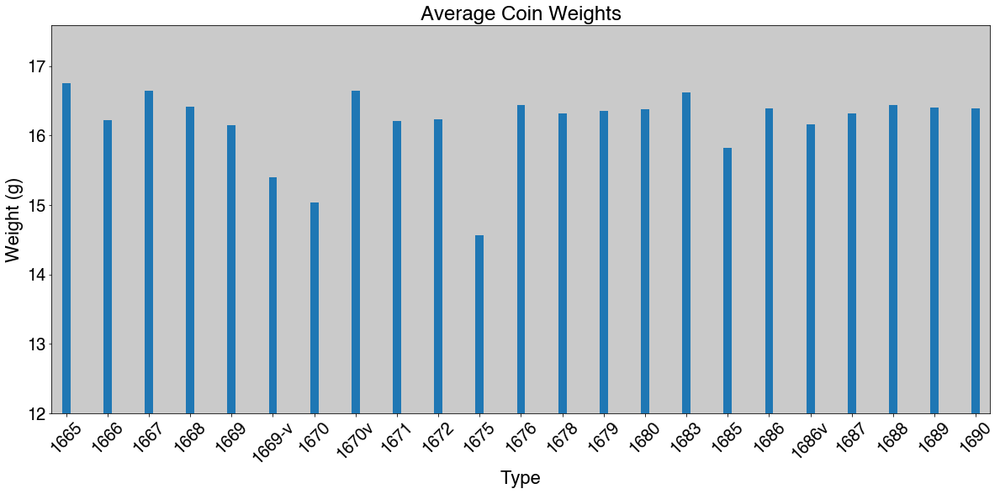

In [10]:
typemeandf = coinCatdf.groupby(['type'])['weight'].mean().copy()
makeweightgraph(typemeandf, 22, "Average Coin Weights", "Type", "Weight (g)", 12, .2)


## Hoards

Temnian coins are well represented in hoard evidence, which assists with dating and establishing circulation patterns of the coinage. Specimens are often found distributed within Seleucid territory alongside issues from Alabanda, Aspendus, Assos, Chios, Cyme, Miletus, Myrina, Mytilene, Perge, and Phaselis, despite the chronological and geographical difference between the production of the various mints. For further information on hoard composition and dating, see the relevant references. Details of the composition of many of the hoards listed below are refined and expanded from initial publications as a result of this study. 


In [11]:
#you can modify the date ranges and the mint to get different hoards; these are all of the hoards that have temnian Alexanders
start_date = -200
end_date = -140
buffer = 2

dfHoard = pd.DataFrame()
dfHoard = hoardsDisplay (mint["temnos"], start_date, end_date, buffer)
dfHoard.style.format({'location_uri': make_clickableBase})

,id,title,count,denomination,type,burial_start,burial_end,contents,discovered_at,location_uri
0,"ch10,308","Gaziantep Environs, Turkey",86,,,-143,-143,1916 AR,1994,https://www.geonames.org/314830
1,"ch10,310","Kirikhan, Turkey",2,,Price 1690,-143,-142,5000 AR,1972,https://www.geonames.org/307657
2,igch1432,"Asia Minor, southern",1,tetradrachm,,-150,-150,22 AR,1964,https://www.geonames.org/10922502
3,igch1559,"Akkar, c. 45 km. SW of Homs (anc. Emesa), Seleucis",37,tetradrachm,,-150,-150,69 AR,1956,https://www.geonames.org/174110
4,"ch10,301",Unknown Findspot (“Demetrius I” hoard),92,tetr,,-151,-150,"529 AR, 3 AU",2002,
5,igch1774,"Babylon, Babylonia",7,tetradrachm,,-155,-150,100 AR tetradr. From excavations,1900,https://www.geonames.org/98228
6,"ch7,99",Asia Minor,2,tetr,,-160,-160,,1947/8,https://pleiades.stoa.org/places/837
7,"ch1,77",Syria,14,,,-170,-160,. 142 + AR,before 1960,https://www.geonames.org/163843
8,"ch10,295","Beqa' Valley, Lebanon",3,,"Price 1676, 1686",-170,-160,c. 40 AR,1995,https://www.geonames.org/280282
9,igch1547,"Khan Cheikhoun, c. 25 km. E of anc. Apameia, Seleucis",2,tetradrachm,,-170,-160,103 AR,1940,https://www.geonames.org/168325


### Hoard Map

In [12]:
MinimumMarkerSize = 8
MaximumMarkerSize = 40
m = createmapvis()
mintHoardMapper(dfHoard, "count", (mint["temnos"]), MinimumMarkerSize, MaximumMarkerSize, m)
m

Other than a small hoard buried in Temnos itself, there is no evidence that Temnian Alexanders circulated broadly within the Attalid kingdom or western Asia Minor generally, although this could be attributed to the vagaries of fate and the survival of relevant evidence. The only other evidence for Temnian issues outside Asia is the Propontis hoard which featured eleven Temnian coins. However, other than the 1665 type, the Temnian coins found in this deposit are almost certainly modern intrusions, given existing evidence from other datable hoards <cite data-cite="2352430/BEAXA5NM"></cite>. The vast majority of Temnian coins, including the large deposits of Tell Kotchek with 197 Temnian coins, the Demitrius I hoard with 92 Temnian coins (possibly deposited in Syria)<cite data-cite="2352430/43K4USCU"></cite>, Gaziantep with 86 Temnian coins, and the Susa hoard with 50 Temnian coins were found in Seleucid territories. 

## Dating

The dating of Temnian issues, based largely on hoard evidence, presents some difficulties. Recent scholarship has shown Price's dating to be largely inadequate. Lorber cites Ma'aret en-Numan, Gazinatep, Akkar, Caiffa, Teffaha, Susa, 'Ain Tab, Baiyada, Propontis, Tell Kotchek, Khan Cheikoun, Metcalf's East Anatolian hoard and the “Demetrius I” hoard to support shifting the dating of 1679, 1683, 1686, 1687 and 1689 to before 162. She also assigns 1677, 1680, and 1681 to 162-151/0 and places 1676 with 1678 to shortly before 151/0 <cite data-cite="2352430/43K4USCU"></cite>.

Omitted from this discussion is the Bequa' valley hoard, which does not factor into Lorber's dating of Temnian issues. This deposit, assigned to the first third of the second century (after 187/6) by Elayi, contains three coins from Temnos, specifically types 1676, 1678, and 1686. The dating of this hoard is based in part on Seyrig's assignment of Tell Kotchek to 160, the lack of datable countermarks on the Temnian and Mytilenian coins, and the presence of countermarks on the coins of Phaselis and Side <cite data-cite="2352430/KCUBEV5C"></cite>. If Elayi's dating is correct then 1676 and 1678 would have to moved back to before the proposed burial of the hoard to before 187/6.

However, the dating of Tell Kotchek, East Anatolia, 'Ain Tab, and Khan Cheickoun have all been revised downwards based on parallels with other firmly dated hoards, with Tell Kotchek and East Anatolia now placed after c. 150 / c. 142 <cite data-cite="2352430/43K4USCU"></cite>. Due to the parallels in countermarks and composition with the Tell Kotchek and the East Anatolia hoards, the date of Bequa' should be lowered to after c. 150 / c. 142. This also eliminates any difficulties in accepting the dates proposed by Lorber and accepted by Meadows and Houghton for the dating of types 1676, 1678, and 1686. These new proposed dates can be refined even further by examining die linkages.

## The Die Study

 Although there is a paucity of evidence for some die types and sometimes spotty representation of certain issues within hoard evidence, it is nevertheless possible to begin a die study on Temnian coins. Reverse monograms are unique to an individual coin type and there is no example of a recut reverse die, allowing for consistent type identification (with a few exceptions noted below). The linkages show several distinct production periods containing issues that exist without any connections to the rest of the Temnian series, revealing that Temnian minting activity was fairly irregular and largely done in distinct groupings.

### Types and Numbers

In [13]:
dfObvinfo = pd.DataFrame()
dfObvinfo = obvinfochart(mint["temnos"])
pd.set_option('display.max_rows',2000)
dfObvinfo

,number_of_coins,number_of_reverse_dies,average_weight,price_types
obverse_die,,,,
t_1665_2,1,1,16.580000,1665
t_1665_3,1,1,0.000000,1665
t_1665_5,12,6,13.974167,1665
t_1666_1,1,1,16.220000,1666
t_1667_1,1,1,16.650000,1667
t_1668_1,25,12,12.241360,"1669,1668,1670v,1670,1669-v"
t_1671_1,3,2,10.716667,1671
t_1671_2,1,1,16.490000,1671
t_1672_1,12,8,14.876667,1672


### Die Links, sized by number of connections

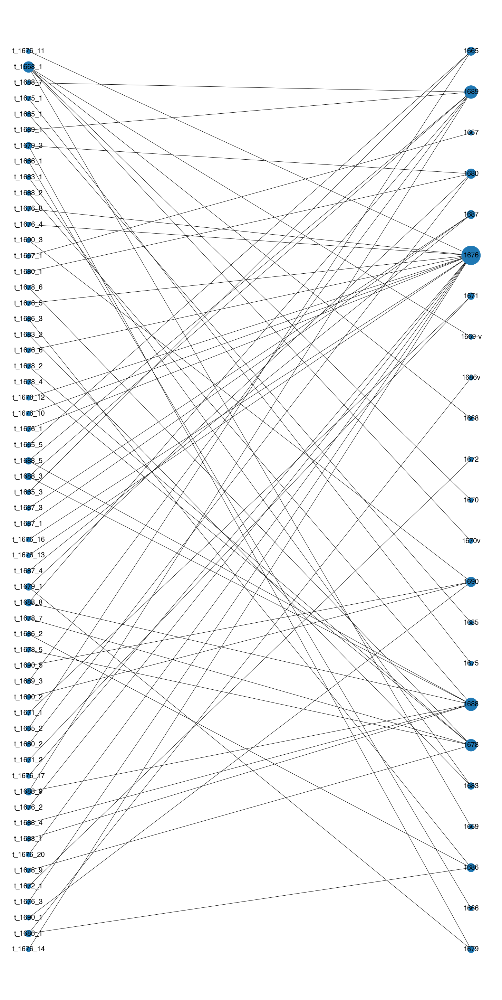

In [14]:
plt.figure(figsize=(20,40))
pos = nx.bipartite_layout(coinGraph, coinCatdf['obverse'].tolist())
nx.draw(coinGraph,pos, node_size=[v * 200 for v in coinGraphDegree.values()])
nx.draw_networkx_labels(coinGraph,pos, font_size=20)
plt.show()


### Coin links as networks

The use of a digital medium allows for even more extensive analysis and visualization of coin links and their connections. Traditional depictions of these connections, like the bipartite graph above, can often be difficult to follow and confusing for the non-specialist. If we view connections as a network, where coins, dies, and types are nodes, we can generate different visualizations that can more readily communicate the intricacies of dies. In this case, we are simply changing the graph from a bipartitie visualization to a typical force-directed graph layout.

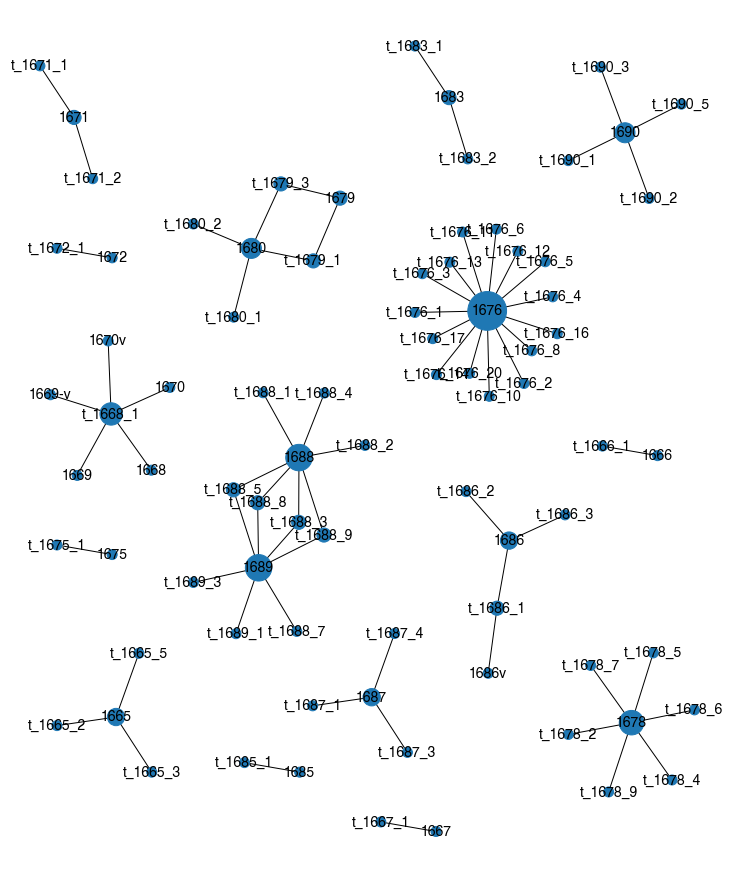

In [15]:
plt.figure(figsize=(10,12))

pos = nx.nx_agraph.graphviz_layout(coinGraph, prog='neato')
nx.draw(coinGraph, pos, node_size=[v * 100 for v in coinGraphDegree.values()])
nx.draw_networkx_labels(coinGraph,pos,font_size=14)
plt.show()

In this view it is much easier to see "clusters" of related types and obverses. This is a basic example; the graph can be further styled to emphasize coin types, reverse dies, or any other aspect of the network. This information can be completely interactive as well; the companion website to this publication offers customizable and browsable networks for each of the mints in the study. Although in its infancy, the approach of treating coin links as networks has far reaching implications. In addition to making information more accessible to a non-specialist audience, we can now combine this network analysis with hoard information and geospatial data to further contextualize minting production.

[![Temnos Interactive Network](img/temnos_net.png)](http://localhost/aeolianalexanders/temnos_net)

### Coin links Analysis

Price 1665 stands on its own without any obverse links to other Temnian types or reverse links to different obverses within the type, making a relative chronology of production impossible. There is also inconsistent placement of the oinochoe's handle on the reverse. On the majority of dies the handle is to the right of the oinochoe, but there is one reverse where the handle is on the left. Present in the Mektepini hoard, Price's assignment of the type to c. 200 is not affected by Meadows' proposal to shift the date of Mektepini to 195 <cite data-cite="2352430/HS64TS4S"></cite>.

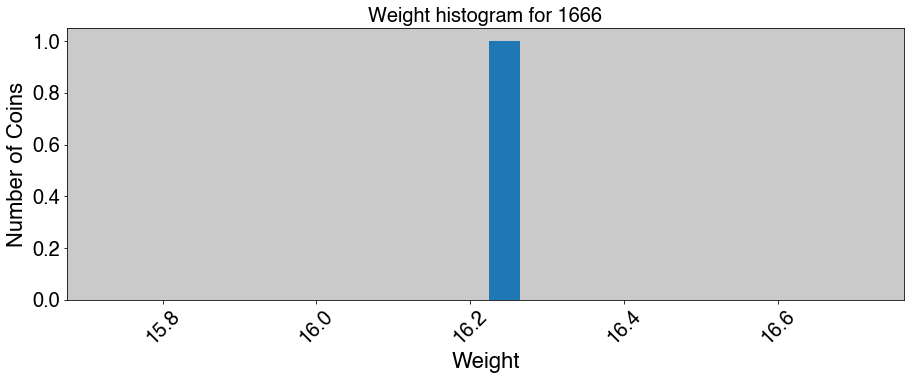

In [16]:
bar_width = .8
coinType = '1666'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


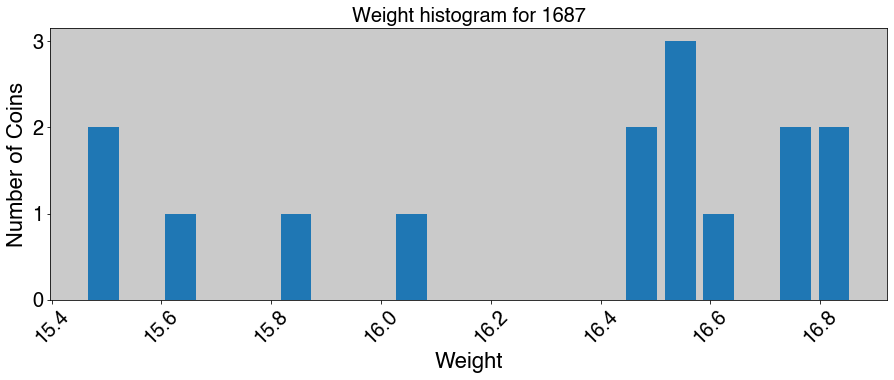

In [17]:
coinType = '1687'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, .8,  histogramSizes['x'],histogramSizes['y'])


1666 along with two new types present some difficulties. 1666 and 1666-v share an obverse die which is remarkably similar to the obverse for ΑΜ, which strongly suggests that both dies were created by the same engraver. The ΑΜ type has the same lettering in a vertical orientation, minus a vine-tendril, as the horizontal monogram of Price 1684 (which is a drachm and is therefore excluded from this study). The 1666-v type lacks a vine-tendril above the oinochoe but has the same initial character as the monogram for type 1687, although there is nearly a four decade difference in the issues. The linkages and stylistic similarities between 1666, 1666-v, and ΑΜ , along with the one-handled oinochoe on the reverse, make the assignment of both new types to Temnos certain. All of these coins should be seen as near contemporary issues, although further refinement beyond Price's initial proposal of c. 200 is not possible due to paltry representation in hoard evidence. 


<table>
  <tr>
    <td> <img src="img/122_o.png" style="width: 300px;"/></td>
    <td> <img src="img/122_r.png" style="width: 300px;"/></td>
   </tr> 
    <tr><a href="https://maps.isaw.nyu.edu/aeolis/coins/122"> <i>166 with a shared link: image from the American Numismatic Society photofile. </i> </a></tr>  
</table>


<table>
  <tr>
    <td> <img src="http://numismatics.org/collectionimages/19001949/1944/1944.100.31415.obv.noscale.jpg" style="width: 300px;"/></td>
    <td><img src="http://numismatics.org/collectionimages/19001949/1944/1944.100.31415.rev.noscale.jpg" style="width: 300px;"/></td>
   </tr> 
    <tr><a href="http://numismatics.org/collection/1944.100.31424?lang=en"> <i>Type 1666-v: coin 1944.100.31415 from the American Numismatic Society</i> </a></tr>  
</table>


<table>
  <tr>
    <td> <img src="http://numismatics.org/collectionimages/19001949/1944/1944.100.31416.obv.noscale.jpg" style="width: 300px;"/></td>
    <td><img src="http://numismatics.org/collectionimages/19001949/1944/1944.100.31416.rev.noscale.jpg" style="width: 300px;"/></td>
   </tr> 
    <tr><a href="http://numismatics.org/collection/1944.100.31424?lang=en"> <i>Type AM: coin 1944.100.31416 from the American Numismatic Society</i> </a></tr>  
</table>


1667, 1669, and 1670, along with two new types share a single obverse die. One of these is found in a single coin, [Ariadne Galleries 1981 #114](https://maps.isaw.nyu.edu/aeolis/coins/493), and is not listed by Price in his catalog of Temnian issues or appear in any subsequent publications as a type issued by the city. The other new type, represented by [Monedas Jesus Vico 1998 #67](https://maps.isaw.nyu.edu/aeolis/coins/1141), is comparable to 1669 but has a different control mark under the throne of Zeus. Due to the similarities of the control marks this could be the result of engraver error instead of a purposeful new type. With the obverse die links to the rest of the series the attribution of both of these new types to Temnos is secure, however the dating of the series needs to be adjusted from that given by Price. Following the Gaziantep evidence analyzed by Meadows and Houghton <cite data-cite="2352430/ETXZEWW7"></cite>, the down-dating of 1669 from 188-170 to before 160 also requires that 1667, 1670, and the new types be be dated to nearly the same period due to their use of an identical obverse die.

<table>
  <tr>
    <td> <img src="https://raw.githubusercontent.com/Aeolian-Alexanders/coins/master/images/493_o.png" style="width: 300px;"/></td>
    <td> <img src="https://raw.githubusercontent.com/Aeolian-Alexanders/coins/master/images/493_r.png" style="width: 300px;"/></td>
   </tr> 
    <tr>
        <td>
        <a href="https://maps.isaw.nyu.edu/aeolis/coins/493"> <i>Coin 493, Ariadne Galleries 1981 #114</i> </a></td></tr>
    <tr>
    <td> <img src="https://raw.githubusercontent.com/Aeolian-Alexanders/coins/master/images/1141_o.png" style="width: 300px;"/></td>
    <td> <img src="https://raw.githubusercontent.com/Aeolian-Alexanders/coins/master/images/1141_r.png" style="width: 300px;"/></td>
   </tr> 
    <tr><td><a href="https://maps.isaw.nyu.edu/aeolis/coins/1141"> <i>Coin 1141, Monedas Jesus Vico 1998 #67</i> </a>
        </td>
    </tr> 
</table>

In terms of relative chronology, with 1667 and 1669 both present in Gazinatep (and with 1670 missing from the hoards list) it is impossible to use hoard evidence to establish the order of the issues. There are five reverse dies for 1669, and two each for 1667 and 1670, showing by far the heaviest use for the obverse die in the 1669 type. The die appears to show the least wear in the production of 1669, with 1667 exhibiting the most wear and the two new types in the middle, indicating that 1669 was likely produced first. There is a possible die break that is apparent in all 1667 specimens and a few 1669 coins, providing further indication that the new types and 1670 were produced earlier. Further refinement is currently not possible.

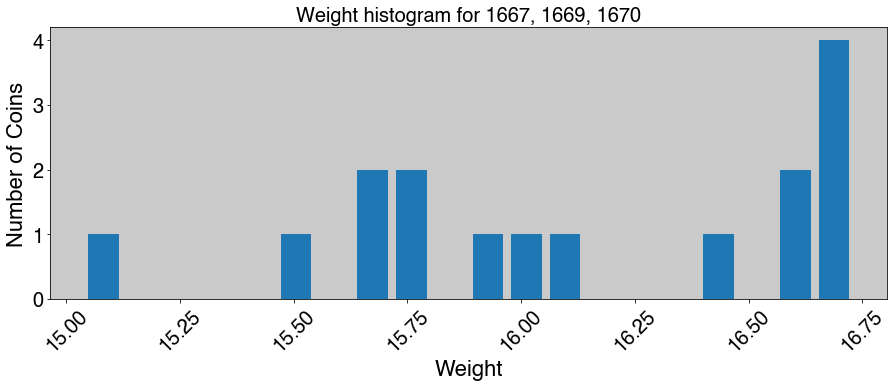

In [18]:
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1667']
coinWeightlist = coinWeightDf['weight'].tolist()
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1669']
coinWeightlist = coinWeightlist + coinWeightDf['weight'].tolist()
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1670']
coinWeightlist = coinWeightlist + coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph('1667, 1669, 1670', cleanedList, .8,  histogramSizes['x'],histogramSizes['y'])


1668, with only one coin and without any obverse links or presence in any hoards, stands on its own and is impossible to place in any chronological context. Type 1671 has two obverse and three reverse dies which are also separate from any other Temnian types. Similarly, 1672 does not share its single obverse die with any other Temnian coins. The assignment of their internal relative chronology is based on die wear, and with 1671 and 1672 only present in the Tell Kotchek hoard it is only possible to give a terminus ante quem of c. 150 for their minting.

There is a strong case for confusion in differentiating 1673, 1674, and 1675, which may instead represent a single coin type. According to Price, 1673 is found in Babylon 1900 #27 and features a stylized ΑΕ under the throne of Zeus, 1674 should have an open ΔΕ under the throne, following Tell Kotchek #20, and 1675 should have a ΔΕ with a bar under the throne <cite data-cite="2352430/MERIQ2BW"></cite>. The ΔΕ and ΔΕ with a bar monograms are both absent from Regling's analysis of the Babylonian hoard <cite data-cite="2352430/A9ACT6AT"></cite>. Price lists 1675 as originating in the ANS Photo File, and the only possible candidate I was able to locate has the distinctive ΔΕ with a bar monogram. When compared to Tell Kotcheck #20 it is immediately apparent that the ANS Photo File and Tell Kotchek #20 are the same coin. Closer magnification of both images seems to highlight the clear presence of lines within the ΔΕ with a bar, which is characteristic of Price 1675. Furthermore, using the plates from Regling's publication of the Babylonian coin, what he identified as A stylized ΑΕ appears to look like the ΔΕ with a bar of 1675, with the side “legs” of the stylized ΑΕ missing. Closer examination reveals that the coins all share the same obverse die and the reverses are remarkably similar (with only the placement of the Ε in ΑΛΕΧΑΝΔΡΟΥ relative to the elbow of Zeus revealing the use of different reverse dies). Although these results are far from conclusive, the die links between the issues and the near identical reverse dies strongly point to the possibility that Price 1673, 1674, and 1675 should be considered a single issue unless coins are found which clearly demonstrate otherwise. At the very least, the shared obverse die points to a nearly contemporary production period.  

1676 and 1678 share two obverse links with each other and a single link with a new type, with complex, overlapping, and chaotic reverse linkages revealing the use of a die box. All three types were almost certainly in production at nearly the same time, making a relative chronology based on die links difficult. In hoard evidence Price 1678 (with five obverse dies in addition to the two shared with 1676) appears before 1676, beginning with the Babylonia 1900 hoard. Price 1676 is by far the most represented type in this study, and first appears in Khan Cheickhoun and is present in every subsequent hoard with Temnian coins, with the exceptions of Southern Asia Minor 1964 and Ladoceia ad Mare. Some obverse dies developed cracks and other damage which assists in the development of a relative chronology, but the overlapping reverse connections for each obverse die makes such a construction highly speculative.


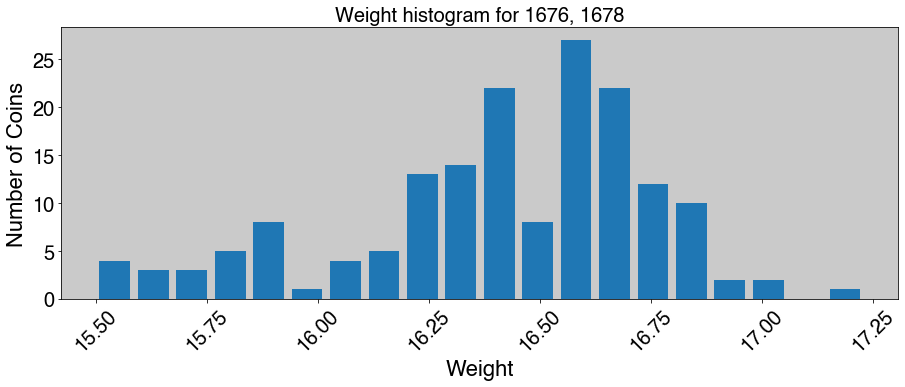

In [19]:
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1676']
coinWeightlist = coinWeightDf['weight'].tolist()
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1678']
coinWeightlist = coinWeightlist + coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph('1676, 1678', cleanedList, .8, histogramSizes['x'],histogramSizes['y'])


1679 and 1680 share two obverse die links with 1680 having two dies on its own. One reverse variant in 1680 has ΑΛΕΞΑΝΔΟΡΥ in place of ΑΛΕΞΑΝΔΡΟΥ, which is certainly engraver error and should not be considered a new type in its own right. The only reverse link between the two obverse dies is of the 1680 type, and the different wear and the development of an obverse crack suggest that 1679 was minted before 1680 in some cases. However, at least one obverse has coins of 1679 and 1680 in production both before and after a die break, showing that both types were minted concurrently. The reuse of dies, along with similar monograms, may suggest that the reverse monograms were more of a stylistic choice than an intentional differentiation in type, perhaps in a similar manner to 1673, 1674, and 1675. Even if this is not the case, both types were certainly produced at the same time. Lorber's suggestion to date 1679 to before 162 BCE and 1680 slightly later to 162-151/0 is supported by the relative chronology of the die links and needs no further refinement <cite data-cite="2352430/43K4USCU"></cite>.

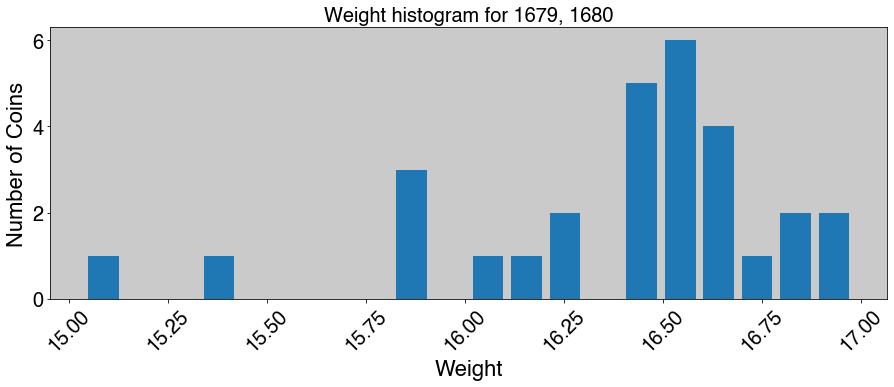

In [20]:
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1679']
coinWeightlist = coinWeightDf['weight'].tolist()
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1680']
coinWeightlist = coinWeightlist + coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph('1679, 1680', cleanedList, .8,  histogramSizes['x'],histogramSizes['y'])


Price 1683 has two obverse dies, sharing one with 1687. This die appears to have some damage above the head of Hercules, which is both present and missing in each type, complicating its use as a chronological marker. As such the production of 1683 and 1687, seems to have occurred at the same time. This shared die has no other reverse connections with 1687, which has a further three obverse dies, one of which lacks any reverse connections to the rest of the series. The majority of the coins in the 1687 type seem to have varying degrees of cracks and other damage on the obverse dies, with only a small number of undamaged coins. This may point to weaker dies, as the number of obverse dies is relatively small for Temnian issues and is not indicative of heavy minting activity. The hoard evidence also does not supply an unambiguous chronology with 1683 and 1687 both appearing for the first time in the Ma'aret en-Numan hoard, with 1683 represented in Demetrius I, Tell Kotchek, and Gazinatep, and 1687 in Babylonia (1900), Demetrius I, Akkar, Tell Kotchek, Anatolia and Gazinatep. There is a further example of 1687 (Münzhandlung Gmbh 148 (1997), #50) that has an obverse die linked to other coins associated with the reconstructed Gazinatep hoard. Although it was excluded in the publication of the hoard, its chronological relation to other coins from commerce used to reconstruct Gazinatep's contents is striking.

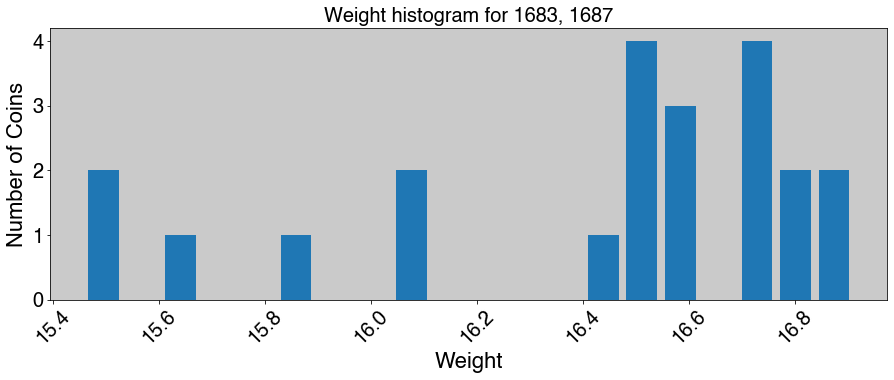

In [21]:
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1683']
coinWeightlist = coinWeightDf['weight'].tolist()
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == '1687']
coinWeightlist = coinWeightlist + coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph('1683, 1687', cleanedList, .8,  histogramSizes['x'],histogramSizes['y'])


With only one example, Price 1685 has no obverse connections with other Temnian coins. Also lacking obverse links to other types, 1686 could be split into two types, with the original reverse monogram and a new monogram that reverses the position of Ρ. It is possible that this difference is the result of engraver error, especially as obverse develops a crack and continues production of 1686 after the Ρ coin. 1686 in general shows a relatively orderly production, with only two reverse dies shared between obverses, including the two examples of the Ρ type. The development of cracks in all of the obverse dies provides a fairly firm minting order. 

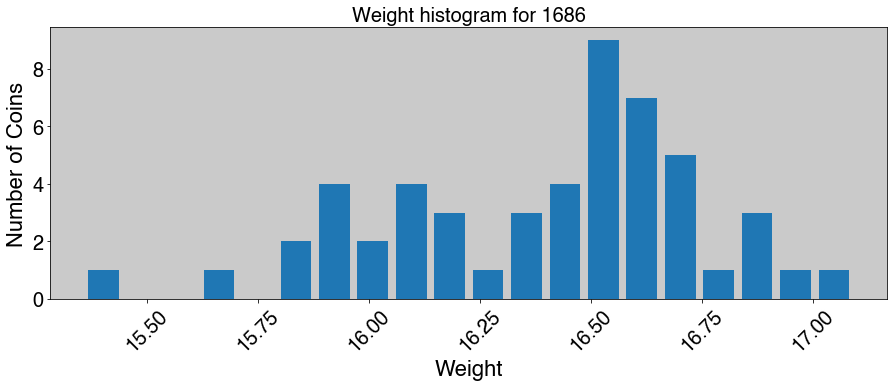

In [22]:
coinType = '1686'
bar_width = .8
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


Price 1688 has three unique dies, shares an additional six with 1689 (which has two more unique dies). Together these three types represent one of the most intensive periods of Temnian minting activity and do not share any links with any other types. Some obverses have chaotic reverse links, showing the probable use of a die box. The remainder of the reverse links are largely orderly and are exclusive to one type. Although there are die breaks that developed during the production of the series, the complex overlaps make it difficult to definitively assign a relative chronology to the types. It seems highly likely that all types, were in production at the same time and should be dated to before 162 BCE to correspond with 1689.

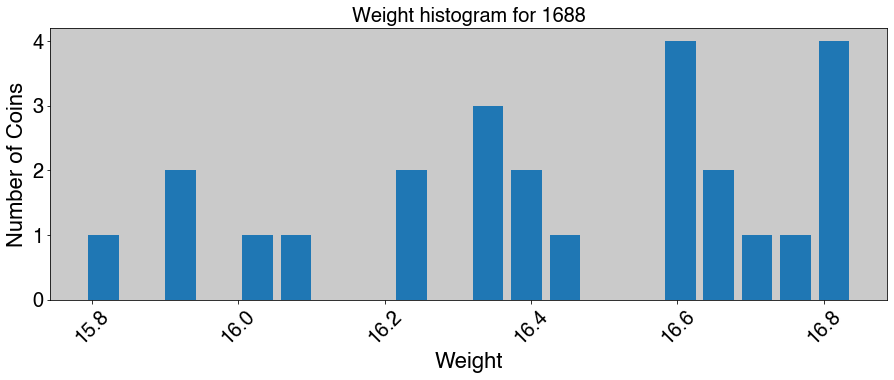

In [23]:
coinType = '1688'
bar_width = .8
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width,  histogramSizes['x'],histogramSizes['y'])


Price 1690, the final issue of Temnian Alexanders, does not share any links with any other Temnian type and is one of the mint's largest issues, with seven obverse dies. In general the reverse links are so chaotic that the use of a die box is certain, with the relative chronology presented in the catalog largely based on obverse breaks and wear. All of the obverse dies used in the die box with the exception of a single coin found in the ANS Photo File from the Eric von Post Collection in Stockholm are present in Tell Kotchek, the first appearance of the type in hoard evidence.

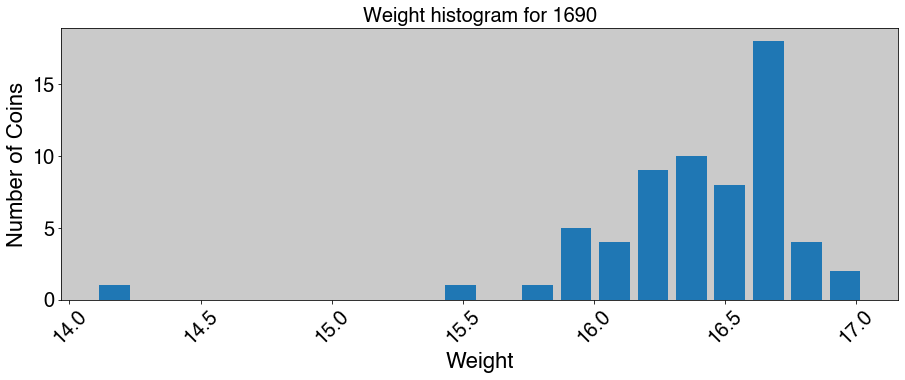

In [24]:
coinType = '1690'
bar_width = .8
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width,  histogramSizes['x'],histogramSizes['y'])


### Countermarks

Very few Temnain coins have countermarks. There are three different countermarks present on Temnain coins, on 1680, 1676, 1690, and one that is 1688/1689.

The countermark on 1680, featuring a head of Zeus, has no parallels in other Greek coinage. Its presence in the Demetrius I hoard requires that the coutnermark be produced before 151-150, which provides no difficulties with the minting of 1680.  

There are two examples of the Priene countermark, ΠΡΙΗ above a Δ , one on 1676 and one on 1688/89. These were published by Regling, who was working under the assumption that Temnian coins dated to c. 190 BCE <cite data-cite="2352430/A9ACT6AT"></cite>. Due to the dating of 1688/1689 to before 162, the date of the countermark should be after 162.The lack of a Prinian countermark on 1690 can be explained by the later date of the issue.

The head of Tyche, present on Price 1690, presents a different problem.  Metcalf presents Price's dating od Kyme coins with the same countermarks, who places them to after c. 155 BCE but still within the 150s <cite data-cite="2352430/G6S55EDT"></cite>. However, the presence of the countermark on Price 1690 requires a reassessment of the dating. 1690 was not present in the Demetrius I hoard of c.151-150 but was certainly minted before Tell Kotchek, which was deposited sometime after 150 and no later than 142. The countermark must then originate from within this period, placing it at the earliest 150, but more likely in the 140s.   

### Hoards, links, and style

Die linkages and hoard reveals complications in the development of Temnian iconography and style. According to Price, there is a significant shift in the reverse imagery of the coinage with the introduction of a vine-tendril above the oinochoe in types 1671-1690. The attribution of both reverse types to Temnos has not been questioned, although assignment to the city is almost exclusively based on the similarities of the vine-tendril design to bronze coins produced beginning in the fourth century, second century silver Apollo hemidrachms, and the types found in the Temnos hoard <cite data-cite="2352430/PB5NE28Z"></cite> <cite data-cite="2352430/XBDVZ4BB"></cite>. The initial assignment originates with Müller, who bases his arguments on the presence of the one-handled oinochoe on the reverse, observing that it is without parallel in other Greek issues <cite data-cite="2352430/3RA6A3SW"></cite>. The handles in question shift position often in the early runs of Temnian coinage, at first placed on the right side of the oinochoe in 1665 (with the exception of ANS 1951.90.7), remaining on the left in 1666, then shifts to the left for 1667 and 1668, on the right for 1669, 1670, and their variants, and finally remains on the left for all of the vine-tendril issues.

Hoard evidence further complicates the situation as types without vine-tendrils are a rarity. Type 1665 is present in Mektepini and CH 10, 292, both dated to before 189. The next Temnian coins attested in hoards which are certainly not modern intrusions are in Ma'aret en-Numan, buried before 162 and containing types 1679, 1683, 1686, 1687, and 1689, all of which feature the vine-tendril design. Khan Cheikhoun, Urfa ( although a possible intrusion), Babylonia, 1900, Khan Cheikhoun, Demetrius I, Southern Asia Minor 1964, Akkar, Trabzon, and Beqa' Valley all only have coins with the vine-tendril design, one coin type without vine-tendrils (1666) appears in Tell Kotchek alongside twelve types of vine-tendril issues. Metcalf's Anatolia hoard along with Northern Syria 1906 only have vine tendril types, and Gazinatep has one tendril-less type (1665) along with ten tendril-types. 

Finally, Kırıkhan, Teffaha, Laodiceia ad Mare, Susa 1933-1934, 'Ain Tab, Bassit, Susa 1947-8 and Media 1923 only have Temnian coins with vine-tendrils. Although it is possible that Temnos first minted the non-tendril design, introduced the tendril design, and then continued to create new coin types without tendrils in limited quantities, it seems most likely that the non-tendril types were produced first, had an extremely limited production run, and did not circulate as broadly as the tendril types. This is supported by the use of only eight obverse dies for non-tendril coins against the fifty-four dies of the vine-tendril types, although non-tendril types had a longer minting period, from c. 200 to before 160, as opposed to before 162 to before 143/2 for vine-tendril issues.

# Hoards as Networks

By embracing linked data and digital techniques, die studies like those presented here can serve not only to illuminate questions on a local or regional scale, but can serve as a window into a much larger phenomenon of social, political, and economic networks in the ancient world. By continuing with the numismatics as networks approach, mints and hoards can be viewed as nodes in a much larger network that spanned the Mediterranean region. Through the use of LOD resources, geospatial analysis, and SNA software, hoards can be used to identify communities of mints, their geographic context, and what impact the political upheaval of the Hellenistic period had on the regional economic networks of Anatolia and the Eastern Mediterranean.


## Methods

In order to study coin hoards as a network which can be studied and visualized it was necessary to create new tools, data structures, and resources. Coin hoards and mints had to be identified, disambiguated, and given a spatial context. The first step in this process was to identify, quantify, and digitize existing hoard data. The American Numismatic Society already has an excellent digital resource, CoinHoards (http://coinhoards.org/) which is based on the print publication Inventory of Greek Coin Hoards (IGCH). This website is designed to be a component of the larger ancient world LOD community, and offers an excellent API which can be used to query the data. However, the underlying database did not have a method to directly tie each mint and its quantity of coinage to each hoard, which necessitated working directly with the ANS to transform the data into a format that was compatible with the network analysis.

Outside of *CoinHoards* and the *IGCH*, the multi-volume *Coin Hoards* series offers a wealth of hoard information, although in a print format. Digitizing this information required painstaking scanning, OCR software, and meticulous checking and review by hand. The result of this work was that information on over 2,000 additional hoards was added to the data from the IGCH, with a total of 4,976 entries in the hoards database. Some of these entries described the same hoard; these were identified, with the cross-references entered into another database table.  An additional table holds the information on the coins found in each hoard; these are sorted by mint, where possible quantified by denomination, material, and type; this table has 25,063 entries. None of these tables should be viewed as definitive; indeed the expectation is that more hoards will be added to the list as they are discovered, identified in commerce, or published in academic literature. This is a “living” resource that can be added to as needed, and as the files are hosted on GitHub they can be edited or expanded with built-in editorial oversight.

After the data was gathered and cleaned, the next step was to associate mints and hoards with spatial data. Pleiades and the ANS have location data for most named mints, so it was a relatively straightforward process to associate the database tables with spatial data. The hoards presented a much larger problem, as many of the places mentioned in the literature have undergone a name change, been absorbed by neighboring communities, abandoned, or otherwise proved impossible to securely locate. In these cases the hoard was assigned to the center point of the next larger containing political unit, such as a county, state, or region. The Recogito tool created by the Pelagios project proved to be an indispensable part of this project, and made it feasible to complete the spatial matching in the allotted timeframe for the project. When this process was completed, .csv versions of the files were sent to the ANS for incorporation into future versions of CoinHoards.

At this point, the cleaned sheets were placed into a PostgreSQL database with the PostGIS and PgRouting extensions, which allow for spatial querying of the underlying data. Networks were constructed by treating the mints and hoards as nodes, with the number of coins of each mint in an individual hoard as the “weight” of a connecting edge. The number of coins was chosen to represent the strength of the connection as many of the entries and publications were unclear as to the denomination and actual physical weight of the coins found in each hoard, and some entries only had vague terminology (like “many”, “few”, and “lots”)  to quantify the number of coins from each mint. As data improves, the strength of the connection between a mint and a hoard could be expressed in terms of silver or some kind of value, but for now this investigation is focusing on the raw quantity of coinage. This allowed for the construction of “ego” networks which highlight the number of other mints and hoards associated with any given mint. This process, and the results of the study, is explained below.

## Hoards in context

This analysis begins by mapping all mints whose coinage was found alongside Temnos. This is a type of co-location network which assumes that there is *some* type of meaningful connection represented in hoards. Although the precise nature of this connection and what it exactly signifies may never be known fully, and abundant caution should be used when using hoard evidence to discuss circulation patterns <cite data-cite="2352430/32TJIJTG"></cite>, viewing Aeolian coinage within the context of hoard networks can help to elucidate larger economic and historic trends in the Eastern Mediterranean.

Our first list shows all of the mints and counts from our database that occur with Temnos.

In [25]:
#you can modify the date ranges and the mint to get different hoards
start_date = -200
end_date = -140
buffer = 2

dfEgoHoard = pd.DataFrame()
dfEgoHoard = hoardsEgoDisplay (mint["temnos"], start_date, end_date, buffer)
dfEgoHoard

,hoard_id,hoard_title,mint_title,mint_uri,count,location_uri
0,"ch10,308","Gaziantep Environs, Turkey","Macedonia, First region",https://nomisma.org/id/macedonia_1st_region,1.0,https://www.geonames.org/314830
1,igch1432,"Asia Minor, southern",macedonia_first region,https://nomisma.org/id/macedonia_1st_region,2.0,https://www.geonames.org/10922502
2,"ch10,292",Unknown findspot,Rose Mint,https://nomisma.org/id/rose_mint_sco,9.0,
3,"ch10,292",Unknown findspot,Callatis,https://pleiades.stoa.org/places/216744,1.0,
4,igch1410,"Mektepini, near Sabuncupinar (between anc. Dor...",callatis,https://pleiades.stoa.org/places/216744,2.0,https://www.geonames.org/302302
5,igch1774,"Babylon, Babylonia",callatis?,https://pleiades.stoa.org/places/216744,1.0,https://www.geonames.org/98228
6,"ch7,93","Propontis, Turkey",Cabyle,https://pleiades.stoa.org/places/216859,1.0,https://www.geonames.org/630669
7,igch1410,"Mektepini, near Sabuncupinar (between anc. Dor...",cabyle,https://pleiades.stoa.org/places/216859,10.0,https://www.geonames.org/302302
8,"ch10,292",Unknown findspot,Mesembria,https://pleiades.stoa.org/places/216882,3.0,
9,"ch7,93","Propontis, Turkey",Mesembria,https://pleiades.stoa.org/places/216882,24.0,https://www.geonames.org/630669


This serves as the basis for a network. Of particular interest to this investigation is the composition of communities, or groupings of nodes which have more intense connections to each other than the rest of the graph. This is a quantifiable method for identifying related nodes, in this case mints which may have deep economic and political ties. Like our coin networks above, the results can easily be visualized. In this case, the nodes are sized according to the number of connections, and are colored according to the detected community (with members of the same community sharing a common color).

In [26]:
dfEgoHoardEdge = dfEgoHoard.groupby(['mint_uri', 'hoard_id',]).sum().reset_index()
coinHoardGraph = nx.from_pandas_edgelist(dfEgoHoardEdge, 'mint_uri', 'hoard_id','count')
coinHoardGraphDict = dict(coinHoardGraph.degree)
partition = community.best_partition(coinHoardGraph)
modularity = community.modularity(partition, coinHoardGraph)

colors = [partition[n] for n in coinHoardGraph.nodes()]
my_colors = plt.cm.Set2 # you can select other color pallettes here: https://matplotlib.org/users/colormaps.html
dataframeResults = {}
dataframeResults = createMapDfs(dfEgoHoard, partition, coinHoardGraph, my_colors)


/Users/ryan/opt/anaconda3/lib/python3.7/site-packages/pandas/core/ops/array_ops.py:253: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  res_values = method(rvalues)


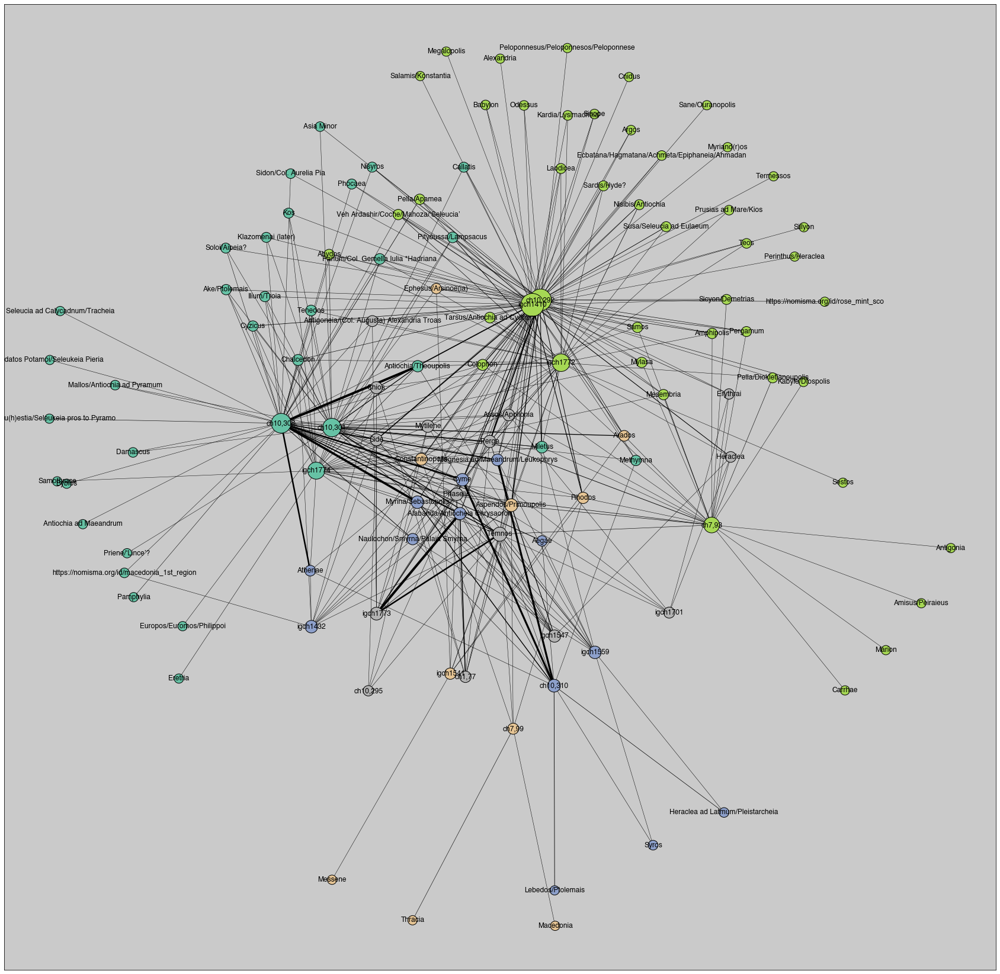

In [27]:
displayCoinEgoHoardGraph (coinHoardGraph, coinHoardGraphDict, 30, 5, 4, .5, 30, 30, dataframeResults['mapDf'], 12)

We can see at a glance the "structure" of the network, or how the more densely packed group in the middle compares to other communities which feature few connections. Unsurprisingly, as Temnos is the "ego", or conceptual center of the graph, its associated community has a tighter structure with more shared links than the rest of the mints. We can pull out whatever community we want from the graph for further analysis; in this case, we will look at the community surrounding Temnos.

In [28]:
mintUri = 'https://pleiades.stoa.org/places/' + mint["temnos"]
#dataframeResults['mapDf'].dataframeResults['mapDf'][dataframeResults['mapDf']['mint_uri'] == mintUri, 'partition'].iloc[0]
df = dataframeResults['mapDf'].copy()
temnoshoardsdf = dataframeResults['hoardsDf'].copy()

partition = df.loc[df['mint_uri'] == mintUri, 'partition'].iloc[0]

df[df['partition'] == partition]

,mint_uri,partition,color,degree,title,lat,lon
23,https://pleiades.stoa.org/places/550434,4,#a6d854,6,Antigoneia/(Col. Augusta) Alexandria Troas,39.756473,26.154750
24,https://pleiades.stoa.org/places/550463,4,#a6d854,8,Assos/Apollonia,39.491111,26.338359
25,https://pleiades.stoa.org/places/550496,4,#a6d854,9,Chios,38.376410,26.134234
27,https://pleiades.stoa.org/places/550535,4,#a6d854,4,Erythrai,38.382361,26.479940
32,https://pleiades.stoa.org/places/550763,4,#a6d854,10,Mytilene,39.110475,26.547048
37,https://pleiades.stoa.org/places/550908,4,#a6d854,17,Temnos,38.671912,27.196998
66,https://pleiades.stoa.org/places/639048,4,#a6d854,10,Perge,36.960009,30.853031
67,https://pleiades.stoa.org/places/639051,4,#a6d854,11,Phaselis,36.522806,30.549049
68,https://pleiades.stoa.org/places/639105,4,#a6d854,9,Side,36.772309,31.394089
92,https://pleiades.stoa.org/places/844944,4,#a6d854,5,Heraclea,41.283255,31.417414


From this simple analysis, we can see that Temnos has a strong association with Aspendos, Phaselis, Perge, Alabanda, Myrina, and Kyme. The visual evidence of similar die styles suggests that Temnos, Kyme, and Myrina were at the very least using the same engravers during their coin production; their strong association with Temnos in the network suggests that there may be some stronger economic and political connections as well. Indeed these were all communities that may have been "free and autonomous" allies with the Attalid kingdom, but were most likely under some form of political control (see Appendix 1 below). 

Hoard networks are inherintly spatial, as the minting and hoarding activity had to occur somewhere. As most of the hoards and mints have spatial data, it is a simple matter to transfer the network onto a map.

In [29]:
m = createmapvis()

hoardsinputdf = dataframeResults['mapDf'].copy()
hoardsinputdf['color'] = hoardsinputdf.apply (lambda row: makeNetColor(row, my_colors), axis=1)

hoardsdf = pd.DataFrame()
hoardsfg = folium.FeatureGroup(name='Coin Hoards Network: {mint}'.format(mint = 'temnos' ))
addFeatureGrouptoMap(hoardsinputdf, hoardsfg, 30, 5, 'degree', 'title', m)
#optional labels - not really necessary when the map is interactive
addFeatureLabelstoMap(hoardsinputdf, 'title', m, 5)
m.add_child(folium.LayerControl())
m

Mapping the mint/hoard community network provides even more insight into the connectivity of cities in western Anatolia. We can clearly see that Temnos, Cyme, Myrina, Mytilene, and Chios are in close geographic proximity to each other; their inclusion in the same minting "community" is fairly unremarkable. On the other hand, mints which have even larger quantities of coinage in the same hoards, like Perge, Aspendus, and Alabanda are located some distance from Temnos, with many other mints from different "communities" between them. This strongly suggests that factors other than geographic proximity played a significant role in the production and distribution of Aeolian Alexanders. To uncover these trends, we will turn to the historical and political context of Aeolian coinage.

# Coins and History

This die study and hoard analysis helps to shed light on the complex history and uncertain political status of Aeolis. Following the battle of Corupedium in 281, the regions of Aeolis and Mysia were nominally under Seleucid suzerainty and there is evidence for subsequent Seleucid minting activity in Aigai, Kyme, Myrina, and Pergamon <cite data-cite="2352430/AW4IQZX6"></cite> <cite data-cite="2352430/B8D6STNT"></cite> <cite data-cite="2352430/JX3XBDSV"></cite>. In 262 the Attalid ruler Eumenes I broke from the conciliatory policies and dependent status of his uncle and predecessor Philetaerus, openly engaging and defeating the Seleucid king Antiochus I at Sardis and winning de facto independence (*Strab* 13.4.2)<cite data-cite="2352430/STTR5FVG"></cite>. Eumenes subsequently extended his control as far as the bay of Cyme, with a boundary stone demarcating the border between Attalid territory and Myrina. The precise status of Temnos and other poleis in Aeolis at the time is murky, but the region seems to have fallen under Attalid control c.227/228 due to the efforts of Attalos I against Gauls and the presumptive Seleucid monarch Antiochus Hierax (*Justin* 27.1).

We can use spatial and network analysis model the changing Attalid kingdom. The seat of Attalid power, Pergamon, is treated as the central node of an ego network, with subject communities connected to it. The probable routes between these communities can be abstracted from Roman roads and navigable waterways, using data produced by the [Ancient World Mapping Center](http://awmc.unc.edu/wordpress/), the [ORBIS project](http://orbis.stanford.edu/), the [Digital Atlas of Roman and Medieval Civilizations](https://darmc.harvard.edu/), and [Harvard's WorldMap](https://worldmap.harvard.edu/). Least-cost pathing analysis in the pgRouting software library is used to construc the most likely route covering the shortest distance between each community and Pergamon; each route segment is then styled by the number of total paths that cross it, with more "used" routes represented by wider lines <cite data-cite="2352430/UBX58GL5"></cite>. The same approach was also used to model the Seleucid and Ptolemaic empires, with the "egos" as Antioch and Alexandria.

The result of this approach is a visual abstraction that privileges axes of communication and connectivity instead of the traditional depiction of clearly defined political territory <cite data-cite="2352430/RPITZK2W"></cite>. This visualization captures the often messy political realities of Hellenistic administration, which often depended more on the direct relationship between an monarch and subject communities than a permanent political apparatus <cite data-cite="2352430/LRE4LD47"></cite>.

### The situation prior to 188 BCE

In [30]:
m = createmapvis()

currentAttalid = attalid_networks_241_197.copy()
currentSeleukid = seleukid_networks_241_197.copy()
currentPtolemy = ptolemaic_networks_241_197.copy()

addNetworkRoutesFromFile(currentAttalid['url'], currentAttalid['featuregroupname'], currentAttalid['sizeproperty'], 'red', 20, 2, m)
addNetworkRoutesFromFile(currentSeleukid['url'], currentSeleukid['featuregroupname'], currentSeleukid['sizeproperty'], 'blue', 20, 2, m)
addNetworkRoutesFromFile(currentPtolemy['url'], currentPtolemy['featuregroupname'], currentPtolemy['sizeproperty'], 'orange', 20, 2, m)

m.add_child(folium.map.LayerControl())

m


Aeolis was likely subsequently reconquered by the Seleucid general and later pretender Achaios, then recaptured by Attalos I in 218 <cite data-cite="2352430/STTR5FVG"></cite>. At this time Cyme, Phocaea, and Smyrna came willingly to Attalos, but Aegae and Temnos only sided with the monarch after having been “terrified” into submission by the approach of the Attalid army, revealing that Temnos was not as enthusiastic as some of its Aeolian neighbors at the prospect of reincorporation into the Pergamine kingdom (*Plb*. 5.77.4: “ἦσαν δ ̓ αἱ τότε μεταθέμεναι πρὸς αὐτὸν πρῶτον μὲν Κύμη καὶ Σμύρνα καὶ Φώκαια: μετὰ δὲ ταύτας Αἰγαιεῖς καὶ Τημνῖται προσεχώρησαν, καταπλαγέντες τὴν ἔφοδον.”). Temnos probably fell from Attalid control and reverted back to Seleucid domination by 197 as a result of the campaigns of Antiochos III (r. 223 – 187) in western Asia Minor. This success was shortlived: conflict soon erupted between Antiochus and Rome, leading to the Syrian War from 192-190 BCE. The Attalids, long allies of Rome, fought against the Seleucids with other independent communities, and the patchwork alliance defeated Antiochus for good at the battle of Magnesia in 190 <cite data-cite="2352430/ZHEU9KT3"></cite>.


The subsequent Peace of Apamea, largely dictated by Rome, settled the political situation and permanently broke Seleucid political power western Anatolia.  with Aeolis falling under the Attalid sphere of influence until the kingdom's dissolution in 133. Rome became the final arbiter in the bitter disagreement between the Attalids and their former ally Rhodes over the settlement of former Seleucid territory and the political status of the region's poleis <cite data-cite="2352430/BBE7J8SZ"></cite><cite data-cite="2352430/STTR5FVG"></cite>. The Roman consul Gnaeus Manlius Vulso finalized the political settlement: cites which supported Rome were to remain free from tribute, tribute cities which paid Attalos were now to pay Eumenes II, and any cities that joined Antiochos were subject to Eumenes (*Plb*. 21.45, *Liv.* 38.39). According to Polybius, newly autonomous cities were Clazomene, Cyme, Drymussa, Mylasa, and the Colophonians in Notium. Rhodes won Lycia and Caria south of the Meander except Telmessus while Eumenes gained control over the European Chersonese, Lysimachia, Heleespontic Phrygia, Greater Phyrgia, Part of Mysia, Lycaonia, the Milyas, Lydia, Tralles, Ephesus, and Telmessus. Phocaea's ancient constitution and former territory were restored to the city, but this does not imply that it was autonomous and in all likelihood it was under the domination of the Attalids.

Although the precise number of subject poleis is a matter of debate, the treaty of Apamea certainly altered the constitutional basis of the Attalid kingdom, offsetting a substantial increase in royal territory and the number of allied and dependent poleis, coupled with a new reliance upon the benefaction of Rome as the guaranteer of Attalid power. In this new political reality, Eumenes faced the difficult problem of incorporating large regions which were formerly under the control of the Seleucids into his kingdom while theoretically respecting the Greek cities' traditional “freedom and autonomy”. Eumenes would have to tread carefully if he was to take advantage of his new position without unduly offending Rome or the newly independent Greek cities which lay along critical axes of communication. 

### Anatolia after 188 BCE, including autonomus cities

In [31]:
m = createmapvis()

currentAttalid = attalid_networks_160_138.copy()
currentSeleukid = seleukid_networks_160_138.copy()
currentPtolemy = ptolemaic_networks_160_138.copy()

addNetworkRoutesFromFile(currentAttalid['url'], currentAttalid['featuregroupname'], currentAttalid['sizeproperty'], 'red', 20, 2, m)
addNetworkRoutesFromFile(currentSeleukid['url'], currentSeleukid['featuregroupname'], currentSeleukid['sizeproperty'], 'blue', 20, 2, m)
addNetworkRoutesFromFile(currentPtolemy['url'], currentPtolemy['featuregroupname'], currentPtolemy['sizeproperty'], 'orange', 20, 2, m)


addNetworkPointsFromFile(autonomus_cities['url'], autonomus_cities['featuregroupname'], 4, 'black', autonomus_cities['popup'], m)

            
m.add_child(folium.map.LayerControl())

m

## Coins and politics

One significant aspect to Eumenes' strategy was his monetary policy, which changed dramatically with the introduction of cistophoroic coins. Cistophoroi were lighter than the Attic standard and were issued throughout the Attalid kingdom, becoming the chief means of monetary exchange in Asia Minor for almost three centuries <cite data-cite="2352430/R9HW96B5"></cite><cite data-cite="2352430/32TJIJTG"></cite>. Interestingly, cistophoroi shared some design elements with civic and Alexander issues common to Asia Minor and Temnos, specifically the ivy-wreath which was featured on the obverse <cite data-cite="2352430/GNWZ65QV"></cite><cite data-cite="2352430/M3TPDTFX"></cite>. The exact history and nature of the cistophoroi remains a matter of contention and obscurity, including if the change was primarily a propagandistic or monetary decision and the precise timeframe of their production <cite data-cite="2352430/BWGAEEXU"></cite>. Scholars date their first issue variably from 200 or earlier, the 190s, 175, and even after 133, while a recent examination of the evidence offers a revised date of 168-133 <cite data-cite="2352430/PXQH43FF"></cite><cite data-cite="2352430/SWV4V23N"></cite>. What is certain is that cistophoroi were produced by a number of cities, perhaps with some level of centralization and oversight from Pergamon. These coins, due in a large part to their lighter weight than their Attic counterparts, rarely circulated outside of areas under direct political control of the dynasty <cite data-cite="2352430/32TJIJTG"></cite>.
	

<img src="http://numismatics.org/collectionimages/19501999/1959/1959.254.37.obv.noscale.jpg" style="width: 300px; float:left"/><img src="http://numismatics.org/collectionimages/19501999/1959/1959.254.37.rev.noscale.jpg" style="width: 300px; float:left"/> 
<br /> [coin 1944.100.31424 from the American Numismatic Society](http://numismatics.org/collection/1959.254.37?lang=en)


The production of cistophoroi was far from universal in the regions within and surrounding the Attalid Kingdom. The minting of Alexanders continued unabated in some Aeolian, Carian, and Pamphylian cities, including Cyme, Myrina, Alabanda, Aspendus, and Phaselis <cite data-cite="2352430/T2ZV3C2J"></cite><cite data-cite="2352430/E8WWVHP4"></cite>. Temnos was also also excluded from the imposition of cistophoric production and continued to mint Alexanders on the reduced Attic standard, although the polis was certainly in territory nominally in the Attalid sphere of influence after 188 <cite data-cite="2352430/PXQH43FF"></cite>. Temnian minting activity primarily occurs within the reigns of the Seleucid king Antiochos III and the Attalid monarchs Eumenes II (r. 197-159) and Attalos II (r. 159-138), a period that began with the polis firmly within Seleucid, not Attalid, control <cite data-cite="2352430/IUV9GASJ"></cite>. The Mektepini hoard proves that the polis began minting Alexanders prior to the battle of Magnesia and nearly concurrently with the campaigns of Antiochos III, especially if the proposed dating of 195 for the hoard is correct <cite data-cite="2352430/PB5NE28Z"></cite>. This places Temnian minting activity alongside other regional Seleucid mints which had a long history of Alexander-type production, which continued well into the Attalid domination of the area <cite data-cite="2352430/88P7ZU49"></cite>.


Unfortunately, the precise political status of Temnos, Myrina, and Kyme is not made explicit by their exclusion from the cistophoric system, Polybius and Livy do not specifically mention the polis in the treaty of Apamea, and the epigraphical evidence confuses the situation even further. There is an extremely fragmentary inscription dated to 197-160/159 in which Eumenes II granted Temnos certain subsidies, which could have included provisions for temples and civic administration (SEG 37.1016; SEG 38.1264; SEG 39 133). Mentioned early in the document is the action of συντάξαντα to an unspecified party (possibly a payment of a tax or other assessment), which Wells presumes was paid to Eumenes II <cite data-cite="2352430/TV48GIEJ"></cite>. Although Temnos received support from Eumenes, it was not necessary for the polis to have been a royal dependent, as benefactions and subsidies were a regular part of Eumenes' foreign policy and do not in and of themselves denote exclusive political control. Even if the σύνταξις mentioned in the decree was a tribute or tax, Temnos could still have had wide latitude in its local administration and foreign affairs, as conceptions of freedom and autonomy (along with required taxes and obligations to a monarch) were extremely elastic in the Hellenistic world <cite data-cite="2352430/D4ZDFQN6"></cite>. The treaty of Apamea as related by Polybius highlights such an ambiguity, as the terms included “...however many of the autonomous poleis that previously paid tribute to Antiochos...” who stayed loyal to Rome were free from paying tribute in the future (*Plb*. 21.46: “...ὅσαι μὲν τῶν αὐτονόμων πόλεων πρότερον ὑπετέλουν Ἀντιόχῳ φόρον...”). This reveals that, at least prior to 188, a polis could be in theory “autonomous” yet still owe tribute or other financial support to a monarch. A polis like Temnos could then owe σύνταξις, or some other fiscal obligation, yet still enjoy a measure of autonomy.

Given the status of Aeolis as a Seleucid possession after 197, it is perhaps most likely that the Temnos would only owe a σύνταξις and receive direct subsides from the Attalids after the peace of Apemea in 188. Therefore the decree should be placed in the period from 188 – 160/159, following the withdraw of direct Seleucid control in the region. Magie argued that the (restored) mention of πρ[ε]σβ[ευταί] in the decree parallels the terminology deployed by autonomous poleis which is further possible evidence that Temnos was not a completely subject community <cite data-cite="2352430/DCAAS595"></cite>. Even if this evidence does not convince, the decree itself does not provide definitive proof that Temnos was a subject community of the Attalid monarchy. 


The importance of another inscription resolving a war between Temnos and Clazomenae to the political status of Temnos should not be minimized. Written c. 200-150, this document records the decisions of the judges of Cnidus to settle a recent conflict between the two poleis (SEG 29.1130 bis A and B =  P. Herrmann, MDAI(I ) 29 (1979) pp. 239-71 = Piejko, MDAI(I ) 36 (1986) pp. 95-97; SEG 36.1040; Robert, REG 1980, 438). Unfortunately, the lack of precise dating in the decree leads to significant difficulties in elucidating the political status of the belligerents and the judges. If the war occurred prior to the peace of Apamea in 188, then it could have been associated with the reconquest of Antiochos III in 197 and a possible general situation of unrest, yet the lack of any royal involvement in such a situation would be puzzling. The war could also have occurred between 197 and the battle of Magnesia in 190, although that would require a conflict between two recently conquered poleis and arbitration by a third without any Seleucid oversight, an unlikely event in a region as volatile and prized as Aeolis. A further complication is that Clazomenae was certainly a supporter of the Attalids, receiving autonomy after 188, and Cnidus seems to have been in a similar situation, making them less likely candidates for a hands-off approach from the Seleucid Empire (*Plb*. 21.45).


A much more compelling case can be made by dating the war to the period following the peace of Apamea. Entirely absent from the decree is the mention of any royal institutions, governors, or other officials from either the Seleucids or Attalids. It is unlikely that Antiochos III would grant autonomy and remain completely disinterested in armed conflict in the volatile region of Aeolis, not least due to its geographic proximity to Pergamum. If the war occurred after 188, then the lack of Attalid officials and the status of Cnidus as arbiter instead of a royal official or commission can be easily explained if Temnos, much like Clazomenae (and likely Cnidus), was autonomous at the time.


There has also been a recent proposal that an isolated issue of Clazomenian coinage has a connection to this conflict, presumably as a method to fund expenditures related to the war effort and paralleling 4th century minting activity by the same city <cite data-cite="2352430/67KBHDM6"></cite>. As a result of this association, the conflict could be be more precisely dated to 170-151, well after the Peace of Apamea and the expansion of the Attalid kingdom. The very significant Temnian issues of types 1688 and 1689, along with 1679 and 1680, also date to this period and together represent one of the largest groups of obverse dies in the series. It is highly attractive to see these types as financing for the war and serving a parallel purpose to the issues of Clazomenae at the same time. The largest Temnian production, represented by 1676 and 1678, occur near the end of this timeframe and could have some connection to the war, although they are more likely a response to the conflict against Prusias II, which is discussed below.


There is a possibility for further refinement in the chronology of this war due to the Temnian charge, dismissed by the Cnidian judges, that Clazomenians shut themselves into a temple and burial ground which was not subject to Clazomenae (and therefore presumably under Temnian control)(*SEG* 29.1130: “κρίνομες δὲ καὶ ὑπὲρ τ[οῦ ἐγ]|[κλήμ]ατος οὗ̣ ἐνεκάλεσαν Τημνῖται Κλαζομενίοις ὑπὲρ τ[οῦ τε]|[μ]έ[ν] oυς καὶ τᾶν ταφᾶν μὴ ἐνόχους Κλαζομενίους τοῖς ἐγ[κεκλη]|[ματ]ος....”). In 156 Prusias II of Bithynia invaded the Attalid kingdom, although it was not until the following year that Attalos finally secured Roman consent to resist the attack <cite data-cite="2352430/STTR5FVG"></cite><cite data-cite="2352430/K3T5BFB3"></cite>. As part of this conflict, the temple of Apollo Cynneius near or in Temnos was despoiled and destroyed by Pruisias in 155 (*Plb*. 32.15: “ὁμοίως καὶ τὸ τοῦ Κυννείου Ἀπόλλωνος τέμενος τὸ περὶ Τῆμνον οὐ μόνον ἐσύλησεν, ἀλλὰ καὶ τῷ πυρὶ διέφθειρεν”). The precise geographical relationship of the temple to Temnos seems to be irrecoverable (Polybius merely mentions that the temenos of the temple is near or at Temnos), and there are no further mentions of the location in literature. Although it is impossible to firmly associate or differentiate the temenos of the Clazomenian conflict and the temple of Apollo Cynneius, the central importance of a temple to both these events is striking. The destruction wrought by Prusisas against the allies of the Attalids seems general and would have likely included a temple that was capable (at least theoretically) of being captured and exploited by a lesser power like Clazomenae. It is therefore highly probable that the conflict with Clazomenae preceded the war against Prusias, unless Temnos rebuilt the temple after 155, entered into an intense conflict with a neighboring community, and then submitted to arbitration prior to 150, which is an extremely unlikely chronology for these events.

The aftermath of the war against Prusias provides some further insight into Temnian autonomy and minting activity. Polybius discusses the indemnities imposed on Prusias II, by which the cities of Aegae, Cyme, Heracleia, and Methymna were given a hundred talents in compensation for the destruction caused by the monarch in addition to the twenty ships, five hundred talents, and the repatriation of any captured territory directly to Attalos (*Plb.* 33.13: “διορθώσασθαι δὲ Προυσίαν καὶ τὴν καταφθορὰν τῆς χώρας τῆς τε Μηθυμναίων καὶ τῶν Αἰγαιέων καὶ τῆς Κυμαίων καὶ Ἡρακλειωτῶν, ἑκατὸν τάλαντα δόντα τοῖς προειρημένοις”). Some modern commentators have taken this passage to mean that cities that were attacked and were not singled out for specific reparations, such as Temnos, were therefore subject to the Attalids since Polybius did not mention their individual compensation from Prusias as part of the treaty's terms <cite data-cite="2352430/DNPDRHR4"></cite>.

This interpretation is not without significant problems, as this portion of Polybius is extremely fragmentary and the author did not always record all aspects or clauses of treaties throughout his work <cite data-cite="2352430/3J4IU6RH"></cite>. The war is also of secondary importance to Polybius, as the section is mostly concerned with the moral failings and impiety of Prusias II instead of a local conflict that only peripherally involves Greek and Roman interaction. Furthermore, the heaviest period of Temnian coinage, the production of types 1676 and 1678, is datable to the shortly before 151/0, a period immediately following the conflict. This production could easily have been the result of an influx of sliver from an indemnity to Temnos which could be part of what was given to Aegae, Cyme, Heracleia, and Methymna, or otherwise not recorded by Polybius and part of a rebuilding effort following the war.

Even if Temnos was technically a subject city immediately following Apamea, the freedom of action revealed in the war against Clazomenae and the minting activity following the war against Prusias supports the contention that Temnos was autonomous before 162. This autonomy did not mean that Temnos and the Attalids did not foster commercial, economic, religious, and other connections, or that Temnos did not follow the political lead of the Attalid monarchy. The Attalids could not readily use cistophoroi for diplomatic or military means outside of their territory due to the overvalued and underweight nature of those issues, so they were largely reliant upon “free” cities to produce coins which were suitable for foreign consumption <cite data-cite="2352430/U38CUHTR"></cite>. Such currency could be the result of taxation, direct payments, or as the result of general economic exchange, especially if the Attalid economic system was as open as recent scholarship suggests <cite data-cite="2352430/PXQH43FF"></cite>. 

The issues of Price 1687, 1689, 1688, 1681, 1680, 1679, 1676, 1678, 1680, and 1690, in addition to their relevance to Temnos itself, illustrate this phenomenon. The quantity of minting activity and the distribution of hoards may suggest some association with the intrigues of Attalos II against Demetrius I Soter, the son of Seleucus IV Philopator. When the Seleucid monarch Antiochos IV died in 164/163 Demitrius quickly took advantage of the situation by staking his claim to the Seleucid throne and executing Antiochos V, the son of Antiochos IV <cite data-cite="2352430/STTR5FVG"></cite>. Eumenes II threw his support behind a certain Alexander I Balas in response, who Eumenes brought forward in 159 as a son of Antiochous IV Epiphanes and promoted this claim directly to the Roman senate. In 153 /152 Alexander Balas invaded Syria from Anatolia at the head of a mercenary army primarily drawn from Attalid and Roman territories along with limited aid from Egypt and Cappadocia. Winning control over the Seleucid kingdom by 150, Alexander's reign was short-lived. He was overthrown by Demetrius I, losing the kingdom and his life in 145 (*Plb*. 3.5.3; 33.15.1-3; 33.18; *Strab.* 13.4.2; *Justin* 35.1.6-9).

The coinage of Temnos and other poleis in Attalid Asia Minor may have some relation to these events. Temnian coinage is found in Urfa, Babylonia, 1900, Khan Cheikhoun, “Demetrius I”, Southern Asia Minor (1964), Akkar, Trabzon, Beqa' Valley, Tell Kotchek, Anatolia (1994), Syria, Gazinatep, and Kırıkhan hoards, all of which date to this period and are within the same general geographic proximity as the conflict between Alexander I Balas and Demitrius. If we return to our visualization of political networks, and perform a similar task connecting Aeolian mints with known hoards, we can see a clear flow of coinage into this volatile region. Again it must be stressed that this approach does not claim that silver went directly from the mints to the hoarding locations, but it merely suggests some portion of mint production, by whatever intermediate mechanisms, found its way into the region. When compared with our previously "idealized" political network diagrams, this reinforces the importance of pre-exsisting economic networks to the quasi-autonomous poleis of Asia Minor. Although the Seleucid Empire no longer controlled the region, it appears as if the economic networks forged under its hegemony were still operational under the new political reality. We can visualize the "flow" of some of these relationships by creating spatial networks between the mints of Aeolis and hoards much like we did for subject communities to an imperial capital.

### Aeolian Mints, hoards, and political networks, 160 - 138 BCE

In [32]:
temnoshoardsdf

,mint_uri,title,lat,lon,partition,color,degree
0,"ch10,292","ch10,292",NaN,NaN,2,#8da0cb,56
1,"ch10,301","ch10,301",NaN,NaN,0,#66c2a5,37
2,"ch7,99","ch7,99",39.630708,30.988834,3,#e78ac3,6
3,igch1432,igch1432,36.787130,34.220010,1,#fc8d62,11
4,"ch1,77","ch1,77",35.000000,38.000000,4,#a6d854,7
5,igch1541,igch1541,34.820990,36.117730,3,#e78ac3,7
6,igch1547,igch1547,35.442080,36.650950,4,#a6d854,10
7,igch1559,igch1559,34.518510,36.369940,1,#fc8d62,11
8,"ch10,295","ch10,295",33.666670,35.833330,4,#a6d854,4
9,igch1772,igch1772,37.212830,38.781740,2,#8da0cb,33


In [33]:
m = createmapvis()

hoardsfg = folium.FeatureGroup(name='Coin Hoards Network: {start_date} to {end_date}'.format(start_date = start_date - buffer,end_date = end_date + buffer ))


currentAttalid = attalid_networks_160_138.copy()
currentSeleukid = seleukid_networks_160_138.copy()
currentPtolemy = ptolemaic_networks_160_138.copy()

addNetworkRoutesFromFile(currentAttalid['url'], currentAttalid['featuregroupname'], currentAttalid['sizeproperty'], 'red', 20, 2, m)
addNetworkRoutesFromFile(currentSeleukid['url'], currentSeleukid['featuregroupname'], currentSeleukid['sizeproperty'], 'blue', 20, 2, m)
addNetworkRoutesFromFile(currentPtolemy['url'], currentPtolemy['featuregroupname'], currentPtolemy['sizeproperty'], 'orange', 20, 2, m)


addNetworkRoutesFromFile(temnos_routes['url'], temnos_routes['featuregroupname'], temnos_routes['sizeproperty'], 'black', 20, 2, m)
addNetworkRoutesFromFile(myrina_routes['url'], myrina_routes['featuregroupname'], myrina_routes['sizeproperty'], 'pink', 20, 2, m)
addNetworkRoutesFromFile(kyme_routes['url'], kyme_routes['featuregroupname'], kyme_routes['sizeproperty'], 'purple', 20, 2, m)




addFeatureGrouptoMap(temnoshoardsdf, hoardsfg, 30, 5, 'degree', 'title', m)
m.add_child(folium.map.LayerControl())

m

The extensive Temnian minting during the time, especially the very large production of type 1690, could have been an extremely beneficial resource for the Attalids to draw upon in support of their own political projects. One attractive possibility for Temnian coins was their use as a medium to pay mercenaries, as soldiers for hire would presumably want some form of wealth that was transferable outside of the Attalid kingdom <cite data-cite="2352430/T2ZV3C2J"></cite>. Such a consideration is clearly shown in an earlier mutiny of mercenaries at Philateria and Attalea against the Attalid monarch Eumenes I (r. 263-241) (*OGIS* 226). As part of a compact ending the disturbance, Eumenes swore to provide his rioting troops with fixed prices for food, back pay, and the ability for a discharged solider to "take his belongings out [of the kingdom] untaxed" ("... ἀτελὴς ἔστω ἐξάγων τὰ αὑτοῦ ὑπάρχοντα"), which speaks to the desire of mercenaries in Attalid service to have some form of moveable wealth or property. Even if the mercenaries enrolled to support Alexander Balas were interested in permanent settlement instead of cash and booty, currency like Temnian Alexanders would be preferable as a means of payment to forces in Seleucid territories as opposed to cistophoroi that only circulated within the Attalid kingdom. Such a use has already been posited for the issues of Myrina and the coinage of Dionysiac artists, and it is not much of a stretch to consider the intensive production of Temnos at the same period and in the same geographic area in a similar light <cite data-cite="2352430/U38CUHTR"></cite> <cite data-cite="2352430/E8WWVHP4"></cite>.

Temnian Alexander production, at least in the major issues, could serve both the needs of the polis and compliment Attalid foreign policy in the east. It seems likely that Temnian autonomy was not grossly infringed upon by the Attalid kingdom, and the production of tetradrachms was a mutually beneficial arrangement where Temnian minting activity could be consumed by the Attalids and their allies and then used as a currency that would be acceptable to a broader constituency than regional and overvalued cistophoic coins. Although circulation patterns and the alignment of Temnian coinage with Attalid political objectives could be construed as an indicator of subordinate status, the literary record, inscriptions, and minting activity taken together strongly suggests that Temnos was autonomous in the same manner as other polies in Aeolis and Western Anatolia. 

Despite falling under direct Attalid control after 188, Pamphylian mints also produced Alexander tetradrachms nearly contemporary with Temnos. Although there has not been a die study on the Alexanders of Aspendus, it appears that production of the coinage stopped in 185/184, certainly overlapping with Price 1665 and possibly other non-tendril types as well. The coinage of Phaselis seems to have ended production in 181/0, which, like the production of Aspendus, corresponds with Price 1666 and possibly other non-tendril types from Temnos <cite data-cite="2352430/HS64TS4S"></cite>. Carrian mints also produced Alexander coinage. Although no proper die study of Alabandan Alexanders has been attempted, minting of the type seems to have occurred from c. 185 – 167, during the supremacy of Rhodes in Caria. These dates correspond with Temnian activity, although some of the more common Temnian types (1676, 1678 and 1690) may have been created after Alabanda switched to an autonomous design sometime before before 140 BCE <cite data-cite="2352430/ZD3D29DQ"></cite>. 


Further contemporary minting of Alexanders occurred in Ionia. Production of Alexanders at Chios was separated into four distinct periods, with 5 obverse dies in period 1 (280-270), 25 obverse dies in period 2 (270-220), 14 in period 3 (202/1 – 190), and 33 in period 4 (190 – 160) <cite data-cite="2352430/RAIF9XFD"></cite>. The production of Temnos at the same time, excluding Price 1690 which postdates this period, was 55 obverse dies to the 33 known at Chios. Alexanders from Perge, ending production c. 191/0 <cite data-cite="2352430/HS64TS4S"></cite>, evidently had a long circulation period and the presence of these coins alongside Temnos in hoards speaks more for a broader distribution than any political or historical reason. 

Caution should be taken in reading too much into the choice of a civic design over Alexanders, as it has been argued that such a shift could be attributed more to fashion and not indicative of a historical impetus <cite data-cite="2352430/K3T5BFB3"></cite>. Furthermore, the distribution of the coinage into Syria after the 170s is not necessarily the part of a direct payment of a minting polis and may have involved prior distributive or acquisition by a third party <cite data-cite="2352430/MERIQ2BW"></cite>. Unfortunately, the paucity of formal die studies for many of the civic Alexander types makes direct comparisons to the scale of Temnian minting activity currently impossible. However, the application of some of the tools and methodologies presented in this study could greatly aid in the quantification and analysis of this coinage; if a similar approach is carried out in other die studies, using the same linked open data formats and principles, then a much clearer picture of Anatolian, if not Mediterranean, coinage is possible.

# Conclusion

Temnian minting activity was sporadic, with distinct groupings of production which often contained more than one reverse type. The dating of 1667, 1670, and 1688 should be adjusted due to the obverse die linkages. More attention needs to be focused on the possible telescoping of 1673, 1674, and 1675 as a single type, unless definitive evidence to the contrary surfaces. The periods of most intensive production (by obverse dies) adhere closely to conflicts between Temnos and its neighbors, along with Attalid intrigues and the extensive internal turmoil within the Seleucid Empire. The historical context of Temnian minting activity, the lack of Temnian cistophoroi, and the political status of Aeolis in general strongly suggests that Temnos was an autonomous polis which produced currency destined for consumption and distribution external to the Attalid kingdom with an interest towards “international” acceptance. The presence of many other cities with similar minting activity reveals that Attalid territories, along with poleis in the Attalid sphere of influence, were not participants in a closed monetary system but were instead part of a broad patchwork of regional, autonomous, civic, and royal coinages that provided different functions and benefits in a largely mutually beneficial manner to the Attalids and the smaller civic institutions of Asia Minor.

# Appendex 1: Alexanders of Kyme and Myrina

Myrina appears to have minted Alexanders from c. 215 to c.170, ceasing before the Latikia hoard, which Mattingly dates to c. 160 <cite data-cite="2352430/4F44MFWT"></cite>. Kymian Alexanders seem to have been produced from 215 to slightly before 170 with the introduction of magistrates' names on the reverse following the declaration of autonomy after the peace of Apamea. The polis later switched to autonomous wreathed coinage after 154, possibly as a response to silver from the indemnities paid by Prusias II <cite data-cite="2352430/MERIQ2BW"></cite>. Therefore, both poleis seemed to stop production before the Temnian shift to vine-tendril design, with Temnian minting activity lasting approximately fifteen years longer than the other mints. 

The number of coins in each of these studies is far less than the coins uncovered from Temnos. Although the extensive library of auction catalogs and fixed price lists in the American Numismatic Society was consulted, there are still some sources which would have been useful for this study which are currently inaccessible due to the global pandemic. However, as this is a database driven project, new coins can easily be added, cataloged, and analyzed, which may change some of the preliminary findings below.

## By the Numbers: Die links, weights, and hoards

### Myrina

In [34]:
coinCatdf = pd.DataFrame()
coinCatdf = coinCatalogWorking(mint["myrina"])

coinGraph = nx.from_pandas_edgelist(coinCatdf, source='obverse', target='type')
coinGraphDegree = dict(coinGraph.degree)

In [35]:
coinCatdf.style.format({'id': make_clickable})

,id,type,obverse,reverse,weight,rotation,size,title
0,749,1648,m_1648_4,mr_41,16.400000,12,,"Classical Numismatic Group, Inc., Triton XIII, 5 Jan 2010 #1287"
1,1453,1648,m_1648_5,mr_40,15.810000,,,"Numismatik Lanz München, Auction 58, 21 November 1991. #197"
2,1699,1648,m_1648_5,mr_40,15.770000,12,38,Münzkabinett der Staatlichen Museen zu Berlin #18252264
3,574,1649,m_1648_1,mr_1,16.700000,,,"Bibliothèque nationale de France, département Monnaies, médailles et antiques, R 4089"
4,1686,1649,m_1648_1,mr_1,16.920000,12,,ANS #1944.100.31407
5,1701,1649,m_1648_1,mr_1,16.920000,12,29,Münzkabinett der Staatlichen Museen zu Berlin #18252266
6,660,1649,m_1648_1,mr_2,16.940000,12,,"British Museum 1898,0602.17"
7,746,1649,m_1649_1,mr_3,17.040000,1,31,"Classical Numismatic Group, Inc., Mail Bid Sale 84, 5 May 2010 #245"
8,1627,1649,m_1649_1,mr_3,17.020000,,32,"Tom Cederlind, Catalog 131, Buy of Bid Sale, 6 July 2004 #69"
9,1704,1649,m_1649_2,mr_4,13.110000,11,31,Münzkabinett der Staatlichen Museen zu Berlin #18252267


In [36]:
dfObvinfo = pd.DataFrame()
dfObvinfo = obvinfochart(mint["myrina"])
pd.set_option('display.max_rows',2000)
dfObvinfo

,number_of_coins,number_of_reverse_dies,average_weight,price_types
obverse_die,,,,
m_k_1,1,1,17.180000,Κ type
m_E_1,3,1,16.886667,Ε type
m_HP_1,2,1,17.120000,ΗΡ type
m_1648_1,5,3,16.866000,"1649,1648"
m_1648_2,1,1,16.910000,1648
m_1648_3,1,1,16.520000,1648
m_1648_4,1,1,16.400000,1648
m_1648_5,9,5,16.426667,"1662,1648"
m_1649_1,2,1,17.030000,1649


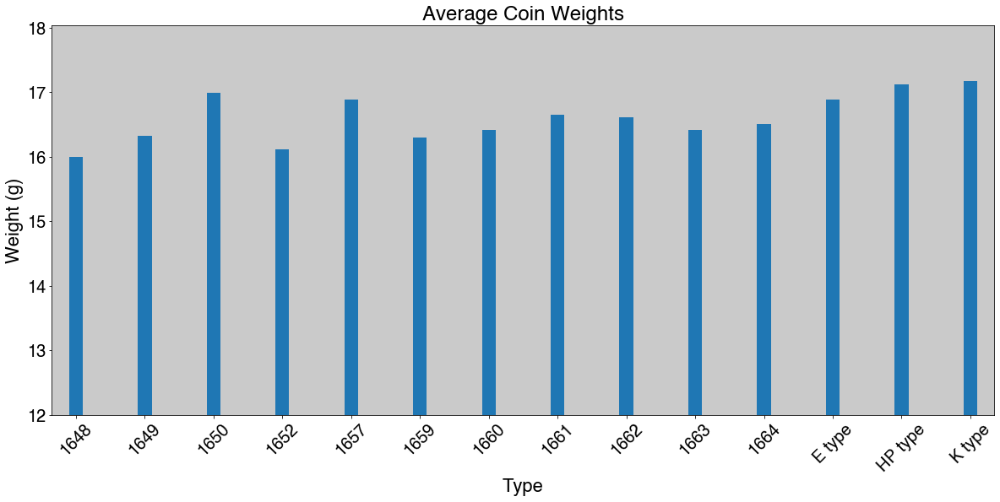

In [37]:
typemeandf = coinCatdf.groupby(['type'])['weight'].mean().copy()
makeweightgraph(typemeandf, 22, "Average Coin Weights", "Type", "Weight (g)", 12, .2)

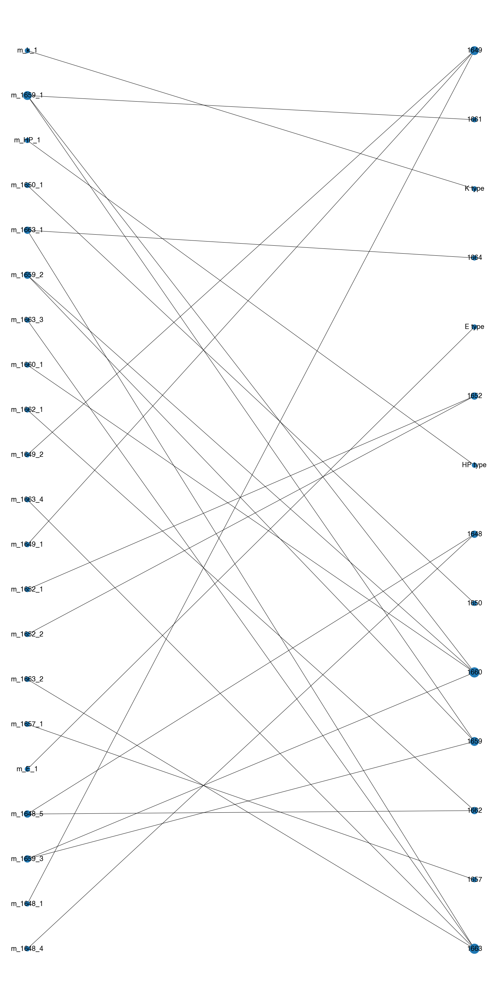

In [38]:
plt.figure(figsize=(20,40))
pos = nx.bipartite_layout(coinGraph, coinCatdf['obverse'].tolist())
nx.draw(coinGraph,pos, node_size=[v * 200 for v in coinGraphDegree.values()])
nx.draw_networkx_labels(coinGraph,pos, font_size=20)
plt.show()


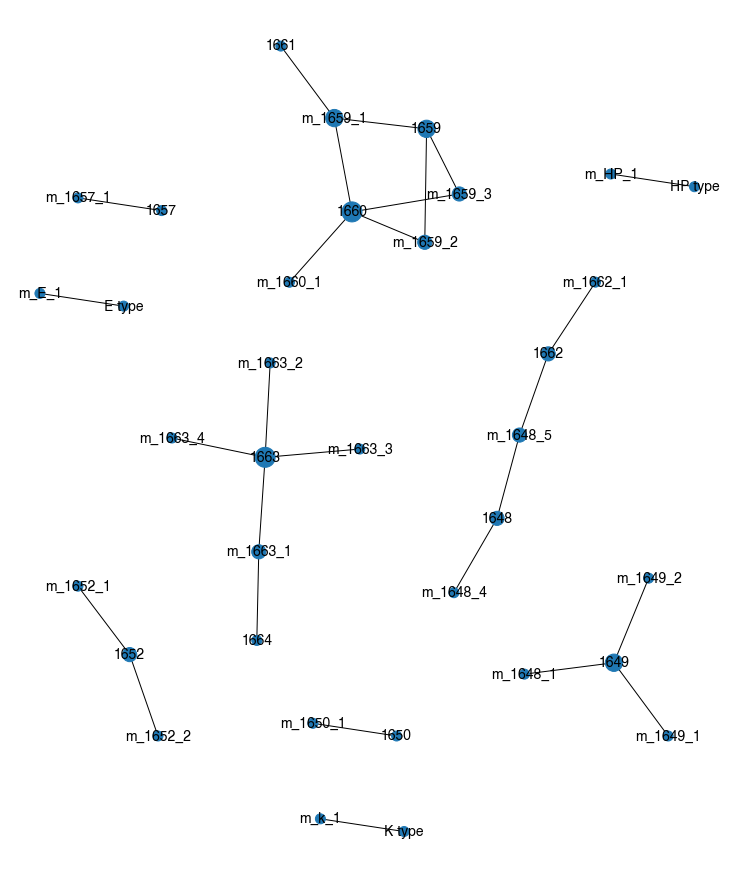

In [39]:
plt.figure(figsize=(10,12))

pos = nx.nx_agraph.graphviz_layout(coinGraph, prog='neato')
nx.draw(coinGraph, pos, node_size=[v * 100 for v in coinGraphDegree.values()])
nx.draw_networkx_labels(coinGraph,pos,font_size=14)
plt.show()

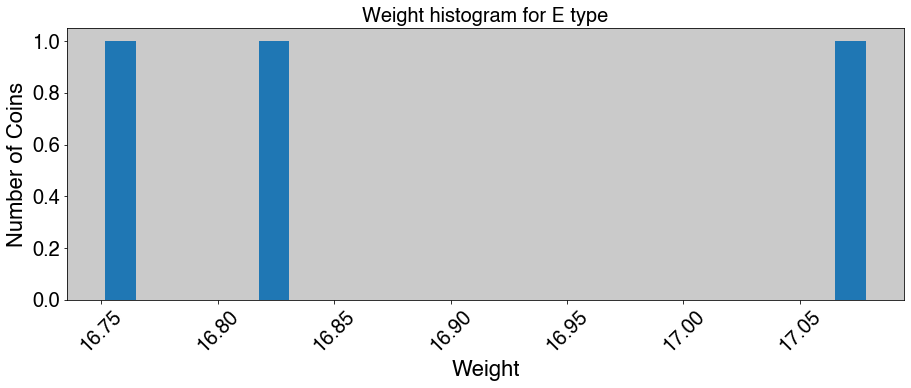

In [40]:
bar_width = .8
coinType = 'Ε type'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


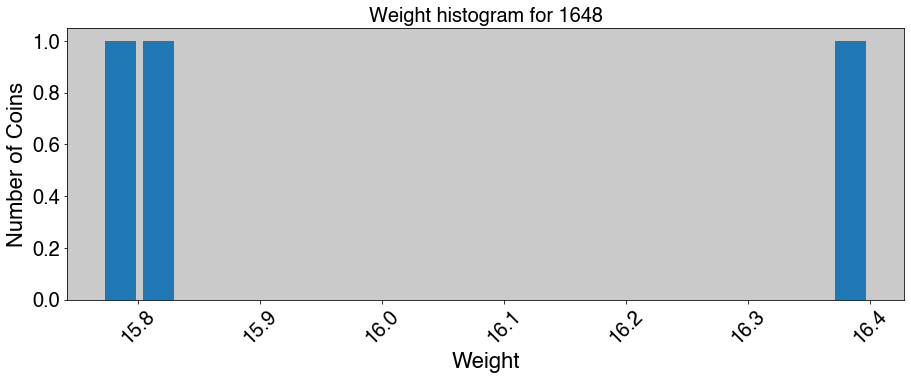

In [41]:
bar_width = .8
coinType = '1648'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


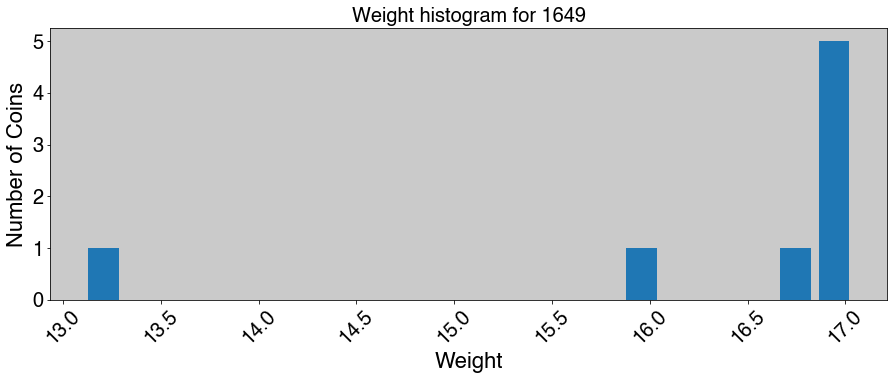

In [42]:
bar_width = .8
coinType = '1649'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


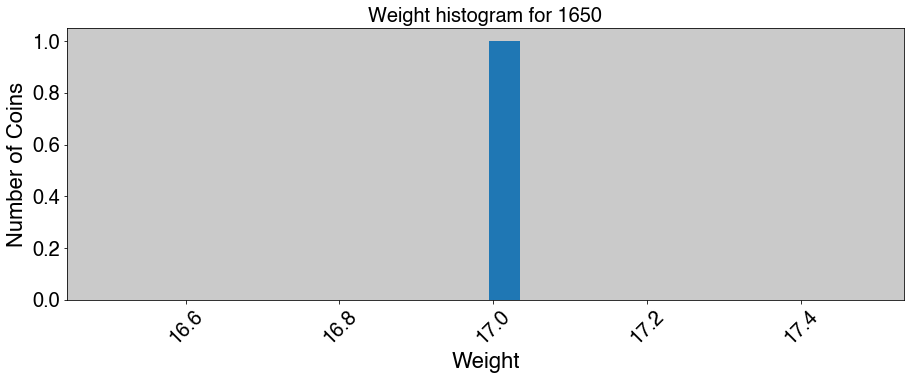

In [43]:
bar_width = .8
coinType = '1650'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


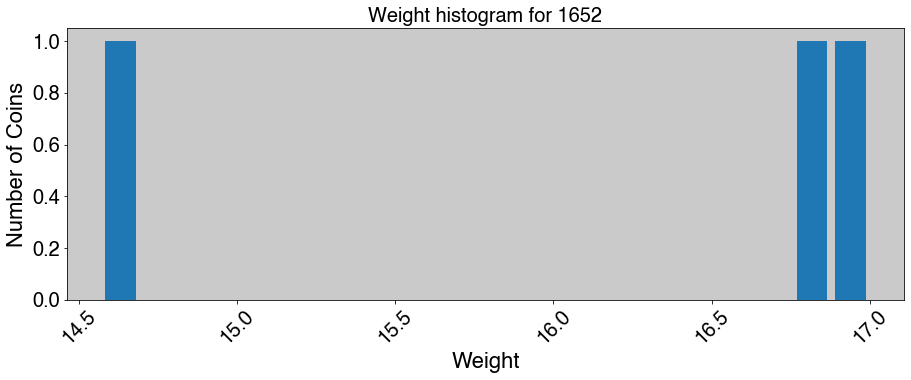

In [44]:
bar_width = .8
coinType = '1652'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


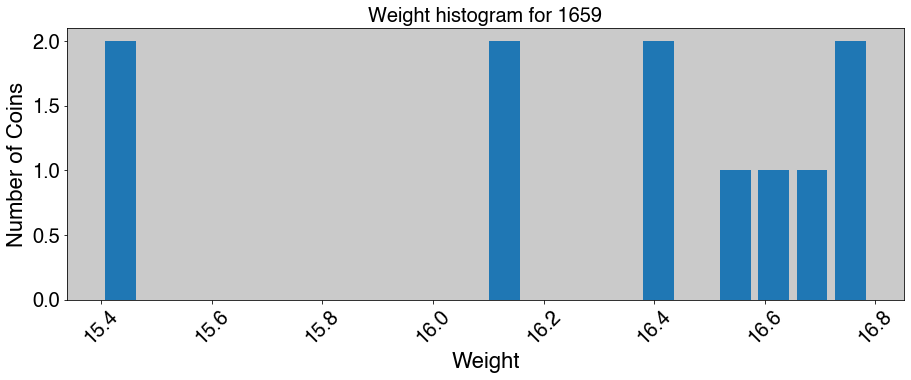

In [45]:
bar_width = .8
coinType = '1659'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


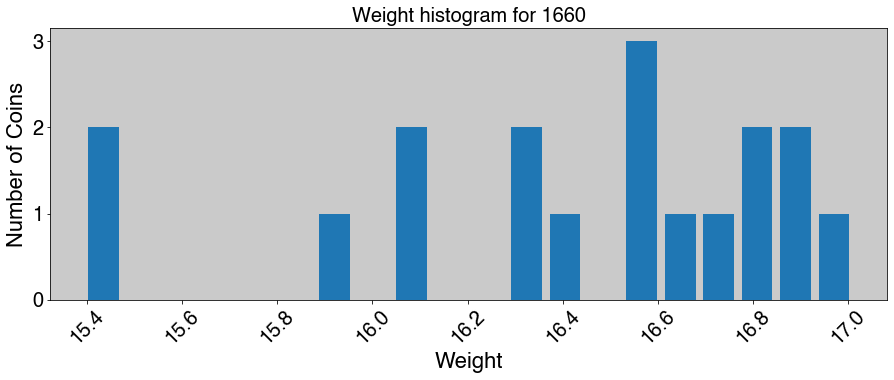

In [46]:
bar_width = .8
coinType = '1660'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


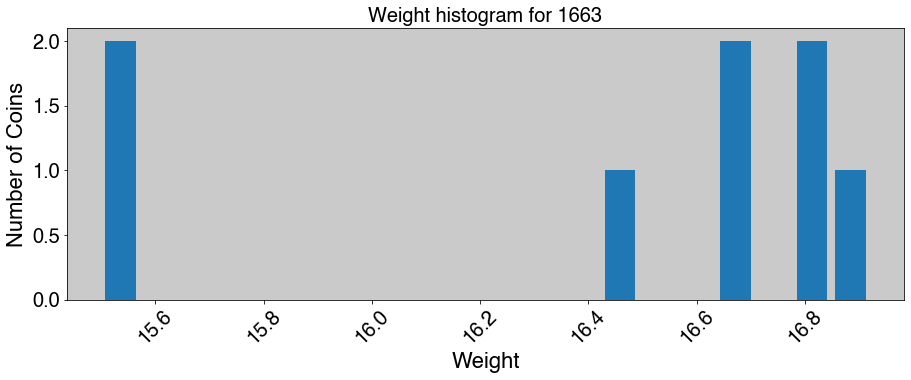

In [47]:
bar_width = .8
coinType = '1663'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


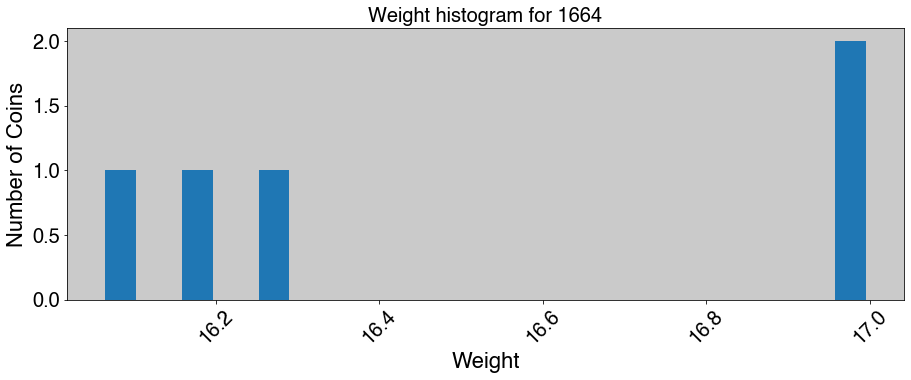

In [48]:
bar_width = .8
coinType = '1664'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


### Kyme

In [49]:
coinCatdf = pd.DataFrame()
coinCatdf = coinCatalogWorking(mint["kyme"])

coinGraph = nx.from_pandas_edgelist(coinCatdf, source='obverse', target='type')
coinGraphDegree = dict(coinGraph.degree)

In [50]:
coinCatdf.style.format({'id': make_clickable})

,id,type,obverse,reverse,weight,rotation,size,title
0,1678,1612,k_1,kr_1,16.780000,12,,ANS #1954.39.3
1,556,1612,k_1,kr_3,16.980000,,,"Bibliothèque nationale de France, département Monnaies, médailles et antiques, 1973.1.52"
2,555,1612,k_2,kr_2,17.040000,,,"Bibliothèque nationale de France, département Monnaies, médailles et antiques, 1971.272"
3,1012,1613,k_4,kr_4,17.160000,,,"Gorny & Mosch Giessener Münzhandlung, Auction 216, 15 Oct 2013 #2303"
4,1011,1613,k_4,kr_4,17.040000,,,"Gorny & Mosch Giessener Münzhandlung, Auction 216, 15 Oct 2013 #2302"
5,1466,1614,k_5,kr_6,17.100000,,30,"Numismatik Naumann (formerly Gitbud & Naumann), Auction 9, 3 Nov 2013 #118"
6,1489,1614,k_5,kr_7,16.990000,1,31,"Roma Numismatics Limited, E-SALE 2, 2 Nov. 2013 #155"
7,665,1615,k_1,kr_8,16.620000,12,,"British Museum 1978,0917.2"
8,656,1617,k_6,kr_10,16.880000,1,,"British Museum 1886,0610.29"
9,1706,1617,k_7,kr_9,17.000000,1,30,Münzkabinett der Staatlichen Museen zu Berlin #18252283


In [51]:
dfObvinfo = pd.DataFrame()
dfObvinfo = obvinfochart(mint["kyme"])
pd.set_option('display.max_rows',2000)
dfObvinfo

,number_of_coins,number_of_reverse_dies,average_weight,price_types
obverse_die,,,,
k_1,3,3,16.793333,"1612,1615"
k_2,1,1,17.040000,1612
k_3,1,1,17.050000,n_l
k_4,2,1,17.100000,1613
k_5,11,8,16.860000,"1614,1619,1618,nl,1634,1621"
k_6,1,1,16.880000,1617
k_7,1,1,17.000000,1617
k_8,1,1,16.460000,1620
k_9,4,3,16.450000,"1628,1622"


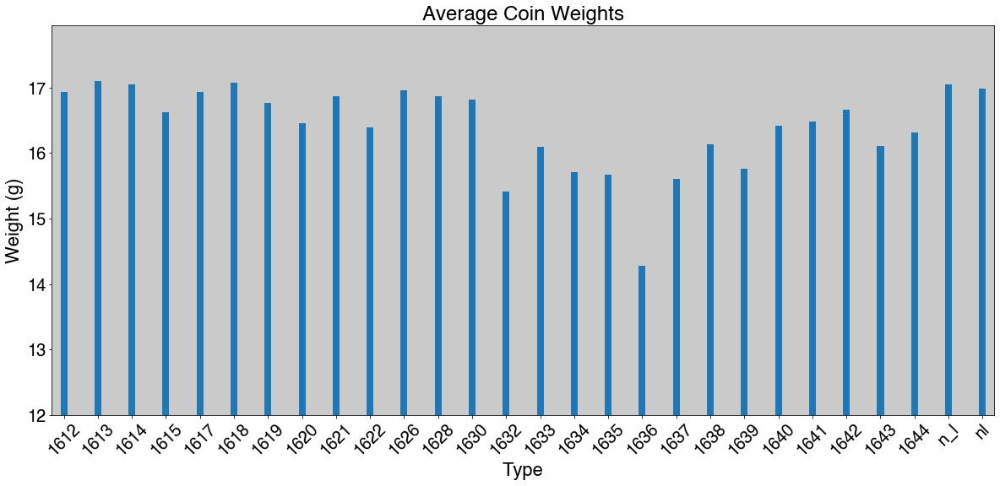

In [52]:
typemeandf = coinCatdf.groupby(['type'])['weight'].mean().copy()
makeweightgraph(typemeandf, 22, "Average Coin Weights", "Type", "Weight (g)", 12, .2)

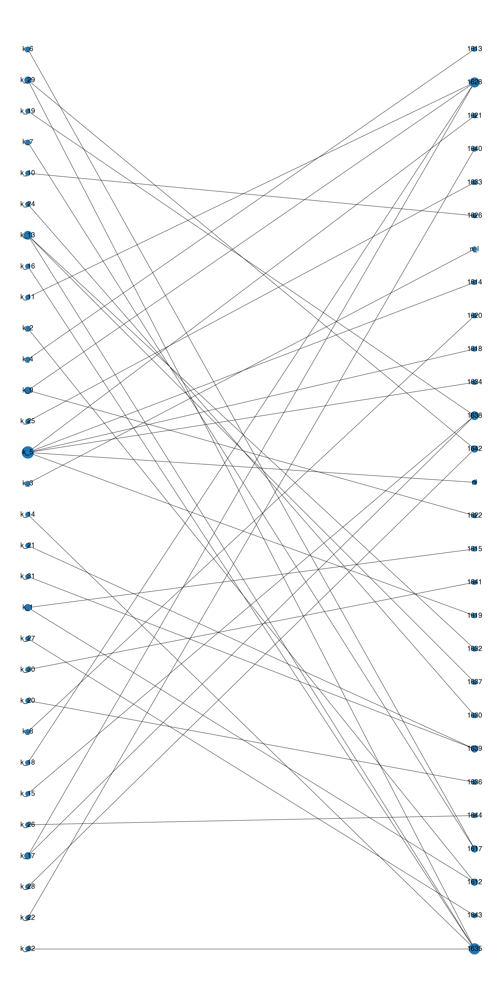

In [53]:
plt.figure(figsize=(20,40))
pos = nx.bipartite_layout(coinGraph, coinCatdf['obverse'].tolist())
nx.draw(coinGraph,pos, node_size=[v * 200 for v in coinGraphDegree.values()])
nx.draw_networkx_labels(coinGraph,pos, font_size=20)
plt.show()

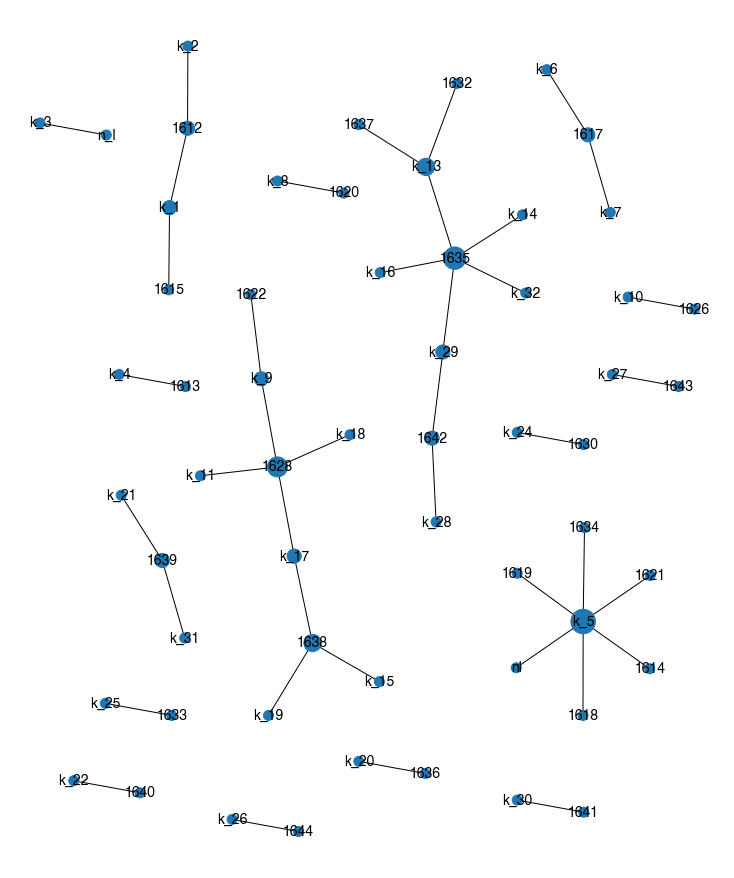

In [54]:
plt.figure(figsize=(10,12))

pos = nx.nx_agraph.graphviz_layout(coinGraph, prog='neato')
nx.draw(coinGraph, pos, node_size=[v * 100 for v in coinGraphDegree.values()])
nx.draw_networkx_labels(coinGraph,pos,font_size=14)
plt.show()

In [55]:
dfObvinfo = pd.DataFrame()
dfObvinfo = obvinfochart(mint["kyme"])
pd.set_option('display.max_rows',2000)
dfObvinfo

,number_of_coins,number_of_reverse_dies,average_weight,price_types
obverse_die,,,,
k_1,3,3,16.793333,"1612,1615"
k_2,1,1,17.040000,1612
k_3,1,1,17.050000,n_l
k_4,2,1,17.100000,1613
k_5,11,8,16.860000,"1614,1619,1618,nl,1634,1621"
k_6,1,1,16.880000,1617
k_7,1,1,17.000000,1617
k_8,1,1,16.460000,1620
k_9,4,3,16.450000,"1628,1622"


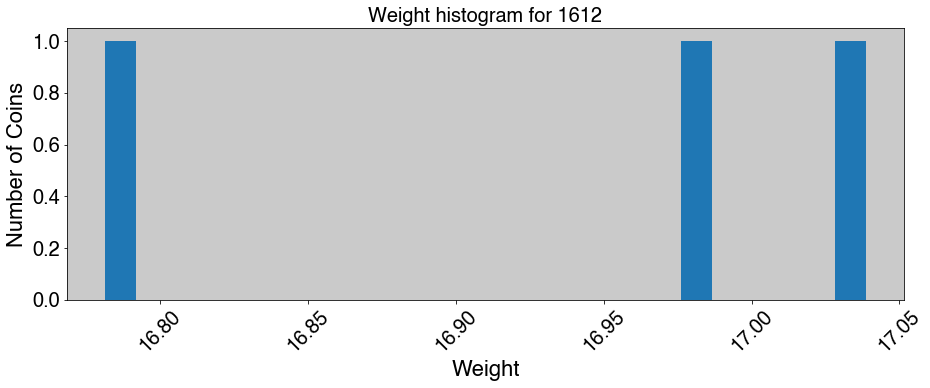

In [56]:
bar_width = .8
coinType = '1612'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


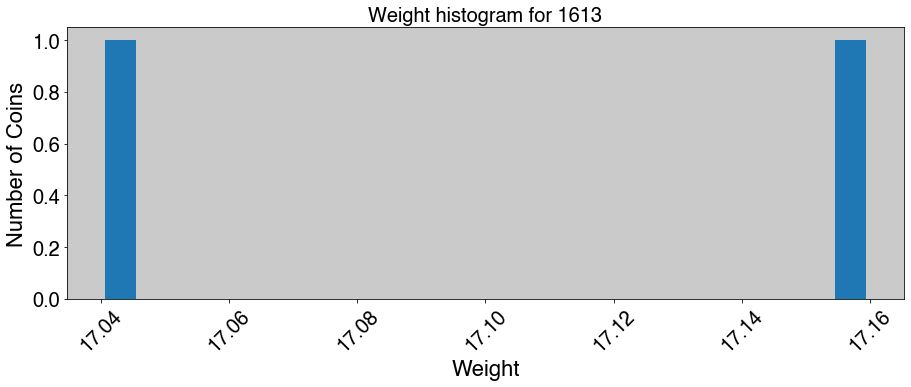

In [57]:
bar_width = .8
coinType = '1613'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


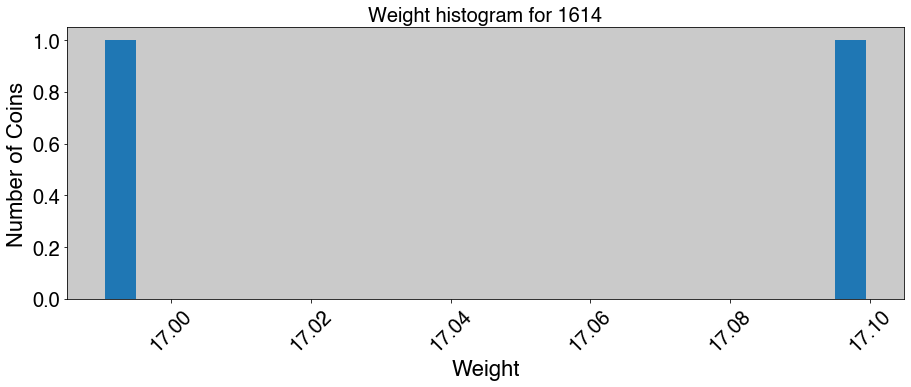

In [58]:
bar_width = .8
coinType = '1614'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


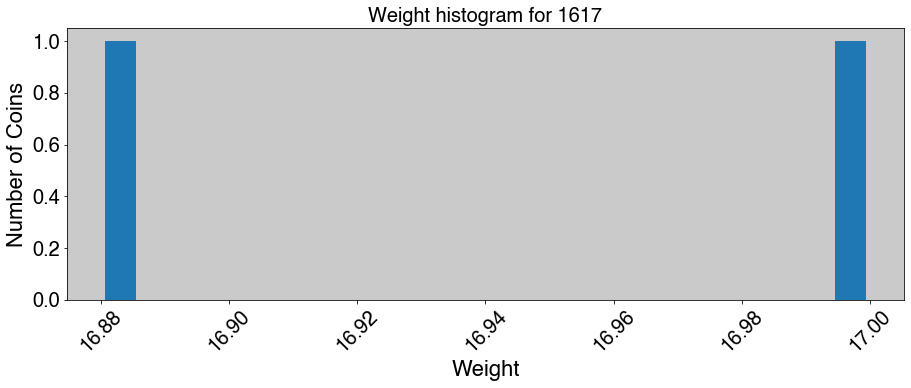

In [59]:
bar_width = .8
coinType = '1617'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


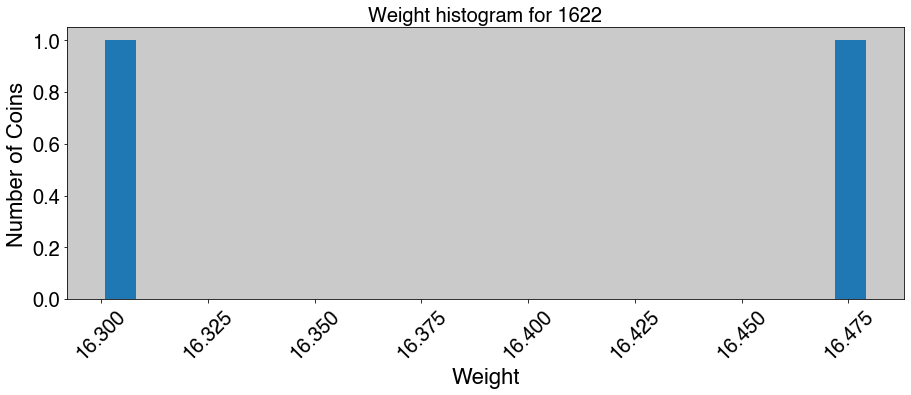

In [60]:
bar_width = .8
coinType = '1622'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


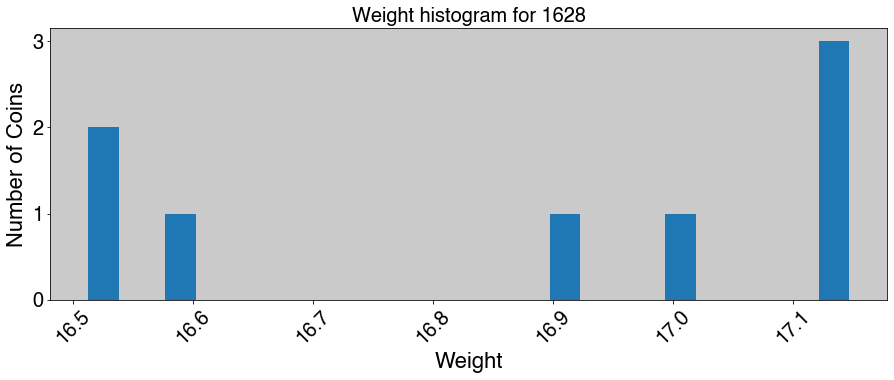

In [61]:
bar_width = .8
coinType = '1628'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


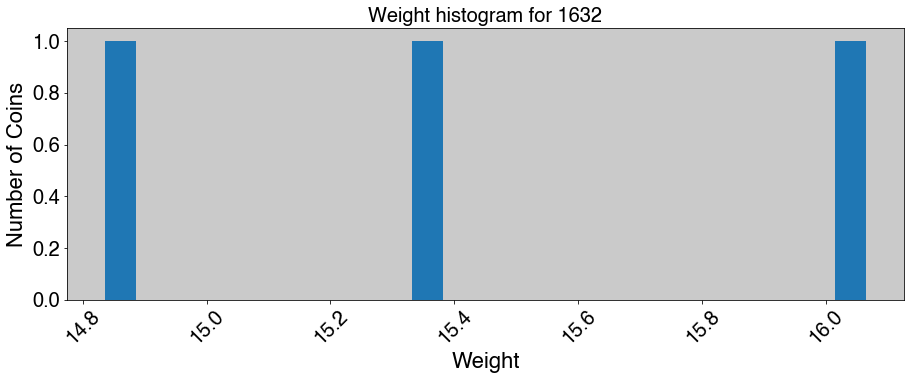

In [62]:
bar_width = .8
coinType = '1632'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


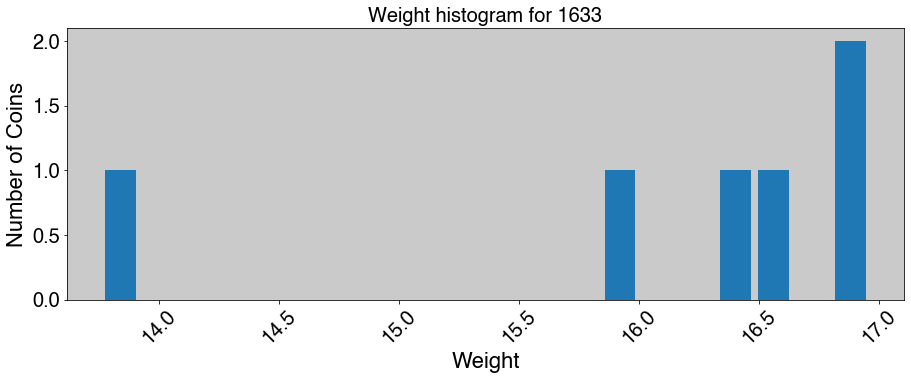

In [63]:
bar_width = .8
coinType = '1633'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


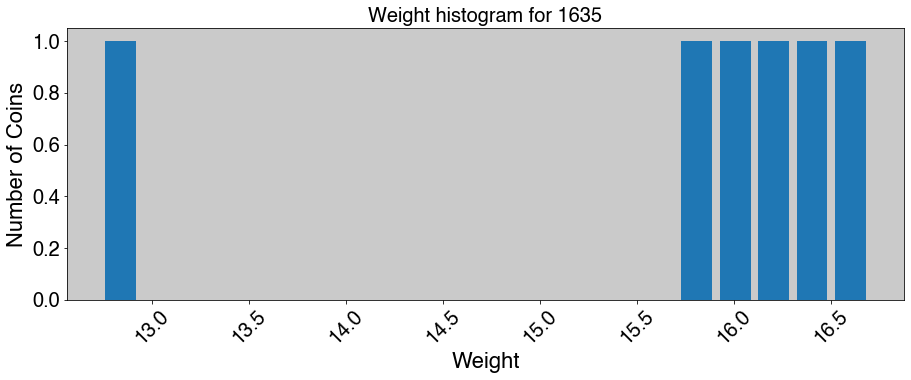

In [64]:
bar_width = .8
coinType = '1635'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


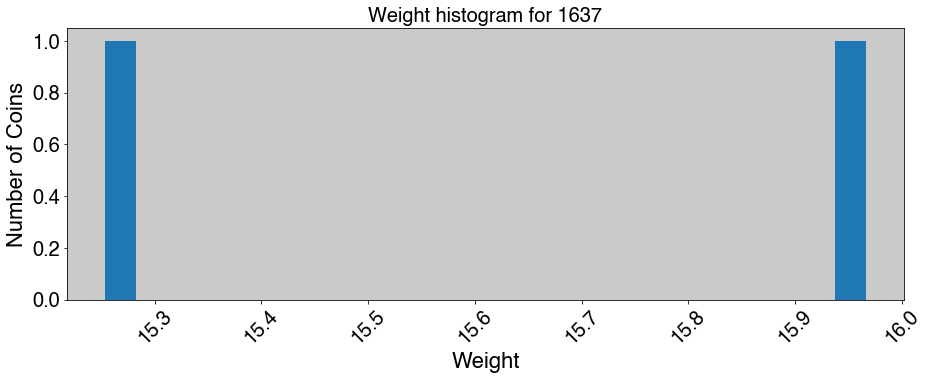

In [65]:
bar_width = .8
coinType = '1637'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


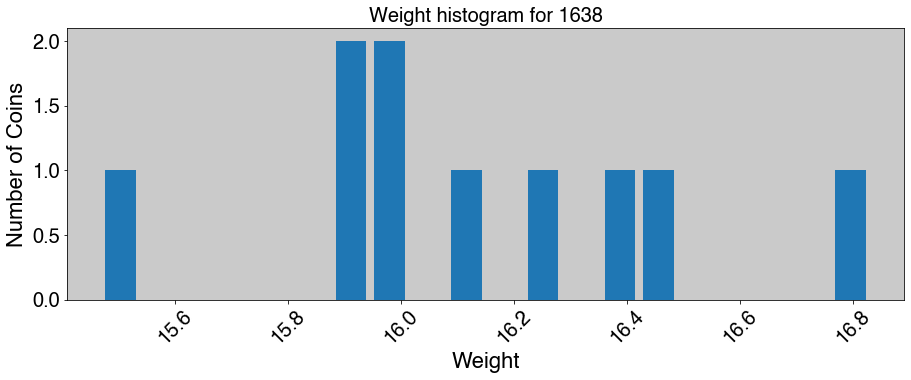

In [66]:
bar_width = .8
coinType = '1638'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


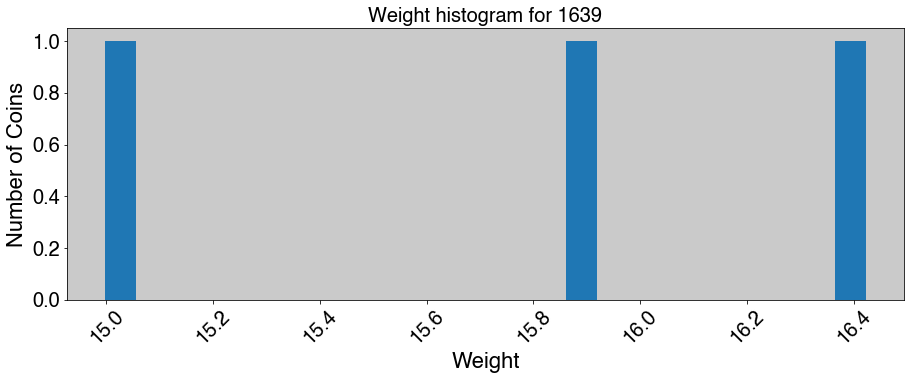

In [67]:
bar_width = .8
coinType = '1639'
coinWeightDf = coinCatdf.loc[coinCatdf['type'] == coinType]
coinWeightlist = coinWeightDf['weight'].tolist()
cleanedList = [x for x in coinWeightlist if str(x) != 'nan']

maketypeweightgraph(coinType, cleanedList, bar_width, histogramSizes['x'],histogramSizes['y'])


## Preliminary Assessment

Although the number of coins in each of these studies is far less than Temnian issues, an analysis of their production and style further illuminates economic and social connectivity in Aeolis. For both mints production seems to occur in specific "groups", with only a few indications of die boxes or shared obverse dies between types. Weights form Myrina remain remarkably consistent, while Kymian coins seem to enter a period of lighter weights until eventually trending upwards again. 

What is extremely interesting is the similarities in style between Temnos, Myrina, and Kyme. Despite the apparent difference in production times, a visual analysis of the obverse dies suggests that the same hand created dies for several different issues for each mint. Due to the short run of the Alexanders and the introduction of civic coinage in Myina and Kyme, it seems unlikely that there was a centralized minting authority which coordinated styles and craftspeople to create the dies. It is more probable that the die engravers operated regionally, selling their services to whatever mint had need of their expertise at that time. Further die studies of other mints, especially ones that are in the same hoard "community", will be necessary to explore these connections further.

<table>
  <tr>
 <img src="https://raw.githubusercontent.com/Aeolian-Alexanders/coins/master/images/1446_o.png" style="width: 300px;"/>
   </tr>
    <center><i><a href="https://maps.isaw.nyu.edu/aeolis/coins/1446">Coin 1446</a></i> from Kyme</center>
    <tr>
         </tr> 
    <tr> <img src="https://raw.githubusercontent.com/Aeolian-Alexanders/coins/master/images/583_o.png" style="width: 300px;"/>
        <tr>
              <center>  <i><a href="https://maps.isaw.nyu.edu/aeolis/coins/583">Coin 583</a></i> From Myrina</center>
         </tr> 
</table>



# Appendex 2: Further Studies in Hoard Networks

Aeolian networks were not the only hoard linkages created for this project; all of the hoards in the *IGCH* and the *Coin Hoards* series were studied as a network, with different communities and time periods represented on a map. Due to the limitations of jupyter notebooks these can not be displayed in an interactive manner here; an animated map is provided below that shows the "flows" of coinage from mints (circles) to hoards (squares) from ~700 BCE to ~300 CE. 

<img src="img/route_networks.gif" width="750" align="center">

This represents first steps in considering the entirety of coin hoards and minting activity as a spatial-temporal network. As more data is collected this process can be refined, perhaps by average weights for each denomination type and the inclusion of surveys, excavations, and single finds data. The routes themselves can be improved with further data from the ORBIS cost model, probable travel paths in the Indian ocean, and further development of political gazetteers. Although this particular project focuses on ancient coinage, there are few limitations to the applicability of this approach to other historical phenomena, including literary, social, political, and religious networks.

# Bibliography

<div class="cite2c-biblio"></div>